Note: the number and quality of accessible scRNA Seq datasets is rapidly increasing with more and more platforms providing streamlined access to single cell omics data such as sfaira, cellxgene etc.

The following notebook shows how we used several scRNA Seq datasets in order to screen for off-tumor toxicities of CAR T target epitopes in 2021.

Since the analysis in this notebook depends heavily on the version of specific packages, current versions may require adapting the code provided below.

The notebook reproduces the preprocessing of multiple scRNA Seq datasets from various healthy tissues and the main figures from the corresponding paper.

First we import required packages:

In [1]:
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import bbknn
import anndata
from gprofiler import gprofiler

import warnings

from rpy2.rinterface import RRuntimeWarning
from rpy2.robjects import pandas2ri

%load_ext rpy2.ipython

warnings.filterwarnings("ignore", category=RRuntimeWarning)
pandas2ri.activate()

plt.rcParams['figure.figsize']=(8,8)
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
sc.settings.verbosity = 3
sc.logging.print_versions()

-----
anndata     0.8.0
scanpy      1.9.1
-----
PIL                 8.1.0
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
brotli              1.0.9
certifi             2020.12.05
cffi                1.14.4
chardet             4.0.0
cloudpickle         1.6.0
constants           NA
cycler              0.10.0
cython_runtime      NA
dask                2020.12.0
dateutil            2.8.1
decorator           4.4.2
future_fstrings     NA
google              NA
gprofiler           1.0.0
h5py                3.7.0
highs_wrapper       NA
idna                2.10
igraph              0.8.3
ipykernel           5.4.3
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.2
joblib              1.0.0
json5               NA
jsonschema          3.2.0
jupyter_server      1.2.1
jupyterlab_server   2.1.2
kiwisolver          1.3.1
leidenalg           0.8.3
llvmlite            0.35.0
louvain             0.7

In [3]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [4]:
sc.set_figure_params(vector_friendly=True, color_map='Reds',
                     dpi=200,transparent=True, fontsize=14)

In [ ]:
# set path for data and results
writepath='path/to/data/'

In [5]:
import sfaira as sfaira

# Lung

For the lung datasets of Travaglini, Madissoon and Reyfman, data and cell annotations were obtained from a study  integrating various lung scRNA-seq datasets (https://doi.org/10.1038/s41591-020-01227-z)

In [6]:
lung_data=anndata.read_h5ad(writepath + 'Muus2021_raw.h5ad')

In [8]:
lung_data.obs.dataset.value_counts()

Stanford_Krasnow_bioRxivTravaglini    60993
Sanger_Meyer_2019Madissoon            57020
Northwestern_Misharin_2018Reyfman     41778
Name: dataset, dtype: int64

## Travaglini

In [9]:
ix=np.isin(lung_data.obs['dataset'],['Stanford_Krasnow_bioRxivTravaglini']) 
adata=lung_data[ix].copy()

In [10]:
adata

AnnData object with n_obs × n_vars = 60993 × 33704
    obs: 'dataset', 'donor', 'last_author/PI', 'original_celltype_ann', 'sample', 'total_counts', 'log10_total_counts', 'n_genes_detected', 'mito_frac', 'ribo_frac', 'compl', 'ann_level_1', 'ann_level_2', 'ann_level_3'
    var: 'n_cells'

In [11]:
# FILTER PARAMETERS
print('Total number of cells: {:d}'.format(adata.n_obs))

#Filter out counts over 40000
sc.pp.filter_cells(adata, max_counts = 50000)
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

#Mito filter
adata = adata[adata.obs['mito_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

#Filter out genes over 7500
sc.pp.filter_cells(adata, max_genes = 6000)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 60993
filtered out 252 cells that have more than 50000 counts
Number of cells after max count filter: 60741
Number of cells after MT filter: 60741
filtered out 108 cells that have more than 6000 genes expressed


Trying to set attribute `.obs` of view, copying.


Number of cells after gene filter: 60633


In [12]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out low count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 33704
filtered out 15129 genes that are detected in less than 20 cells
Number of genes after cell filter: 18575


In [13]:
adata

AnnData object with n_obs × n_vars = 60633 × 18575
    obs: 'dataset', 'donor', 'last_author/PI', 'original_celltype_ann', 'sample', 'total_counts', 'log10_total_counts', 'n_genes_detected', 'mito_frac', 'ribo_frac', 'compl', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'n_counts', 'n_genes'
    var: 'n_cells'

In [14]:
adata.X=sp.sparse.csr_matrix.todense(adata.X)

In [15]:
adata_pp=adata.copy()

In [16]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

normalizing by total count per cell
    finished (0:00:08): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    with n_comps=15
    finished (0:00:29)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:17)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 17 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:20)


In [17]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [18]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

R[write to console]: Loading required package: scran

R[write to console]: Loading required package: SingleCellExperiment

R[write to console]: Loading required package: SummarizedExperiment

R[write to console]: Loading required package: GenomicRanges

R[write to console]: Loading required package: stats4

R[write to console]: Loading required package: BiocGenerics

R[write to console]: Loading required package: parallel

R[write to console]: 
Attaching package: ‘BiocGenerics’


R[write to console]: The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


R[write to console]: The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


R[write to console]: The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    d

In [19]:
#Delete adata_pp
del adata_pp
adata.obs['size_factors'] = size_factors

In [21]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [22]:
adata.raw = adata

In [23]:
#Normalize data

adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [24]:
adata

AnnData object with n_obs × n_vars = 60633 × 18575
    obs: 'dataset', 'donor', 'last_author/PI', 'original_celltype_ann', 'sample', 'total_counts', 'log10_total_counts', 'n_genes_detected', 'mito_frac', 'ribo_frac', 'compl', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'n_counts', 'n_genes', 'size_factors'
    var: 'n_cells'
    uns: 'log1p'
    layers: 'counts'

In [25]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [28]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)


In [30]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:18)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:15)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:06)


In [53]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['ann_level_3'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['2_Mesothelium', '2_Smooth Muscle', 'AT1', 'AT2',
       'Airway smooth muscle', 'Arterial', 'B cell lineage', 'Basal',
       'Bronchial Vessel 1', 'Bronchial Vessel 2', 'Capillary',
       'Capillary Intermediate 1', 'Capillary Intermediate 2',
       'Dendritic cells', 'Fibroblasts', 'Fibromyocyte',
       'Innate lymphoid cells', 'Lymphatic EC', 'Macrophages', 'Mast cells',
       'Megakaryocytes', 'Monocytes', 'Multiciliated lineage',
       'Myofibroblasts', 'Rare', 'Secretory', 'Submucosal Secretory',
       'T cell lineage', 'Venous'],
      dtype='object')

In [54]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['2_Mesothelium', '2_Smooth Muscle', 'AT1', 'AT2',
       'Airway smooth muscle', 'Arterial', 'B cell lineage', 'Basal',
       'Bronchial Vessel 1', 'Bronchial Vessel 2', 'Capillary',
       'Capillary Intermediate 1', 'Capillary Intermediate 2',
       'Dendritic cells', 'Fibroblasts', 'Fibromyocyte',
       'Innate lymphoid cells', 'Lymphatic EC', 'Macrophages', 'Mast cells',
       'Megakaryocytes', 'Monocytes', 'Multiciliated lineage',
       'Myofibroblasts', 'Rare', 'Secretory', 'Submucosal Secretory',
       'T cell lineage', 'Venous'])

In [55]:
ix=np.isin(ref_cluster,['AT2'])
ref_cluster[ix]='AT1'

ix=np.isin(ref_cluster,['Airway smooth muscle'])
ref_cluster[ix]='2_Smooth Muscle'

ix=np.isin(ref_cluster,['Bronchial Vessel 2'])
ref_cluster[ix]='Bronchial Vessel 1'

ix=np.isin(ref_cluster,['Capillary Intermediate 1', 'Capillary Intermediate 2'])
ref_cluster[ix]='Capillary'

ix=np.isin(ref_cluster,['Fibromyocyte'])
ref_cluster[ix]='Fibroblasts'

ix=np.isin(ref_cluster,['Submucosal Secretory'])
ref_cluster[ix]='Secretory'

In [56]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['2_Mesothelium', '2_Smooth Muscle', 'AT1', 
                                                       'Arterial', 'B cell lineage', 'Basal',
       'Bronchial Vessel 1',  'Capillary',
       'Dendritic cells', 'Fibroblasts',
       'Innate lymphoid cells', 'Lymphatic EC', 'Macrophages', 'Mast cells',
       'Megakaryocytes', 'Monocytes', 'Multiciliated lineage',
       'Myofibroblasts', 'Rare', 'Secretory',
       'T cell lineage', 'Venous'])

In [57]:
adata.obs['CellType_Atlas'].cat.categories

Index(['2_Mesothelium', '2_Smooth Muscle', 'AT1', 'Arterial', 'B cell lineage',
       'Basal', 'Bronchial Vessel 1', 'Capillary', 'Dendritic cells',
       'Fibroblasts', 'Innate lymphoid cells', 'Lymphatic EC', 'Macrophages',
       'Mast cells', 'Megakaryocytes', 'Monocytes', 'Multiciliated lineage',
       'Myofibroblasts', 'Rare', 'Secretory', 'T cell lineage', 'Venous'],
      dtype='object')

In [58]:
adata.rename_categories('CellType_Atlas', ['Mesothelial', 'Smooth muscle', 'Alveolar', 'Arterial', 'B cells',
       'Basal', 'Bronchial', 'Capillary', 'Dendritics',
       'Fibroblasts', 'Innate Lymphoid', 'Endothelial', 'Macrophages',
       'Mast', 'Megakaryocytes', 'Monocytes', 'Multiciliated',
       'Lymphoid', 'Remove', 'Secretory', 'T cells', 'Venous'])

In [60]:
adata.write(writepath + 'travaglini2020_processed.h5ad')

## Madissoon

In [33]:
ix=np.isin(lung_data.obs['dataset'],['Sanger_Meyer_2019Madissoon']) 
adata=lung_data[ix].copy()

In [34]:
adata

AnnData object with n_obs × n_vars = 57020 × 33704
    obs: 'dataset', 'donor', 'last_author/PI', 'original_celltype_ann', 'sample', 'total_counts', 'log10_total_counts', 'n_genes_detected', 'mito_frac', 'ribo_frac', 'compl', 'ann_level_1', 'ann_level_2', 'ann_level_3'
    var: 'n_cells'

In [35]:
# FILTER PARAMETERS
print('Total number of cells: {:d}'.format(adata.n_obs))

#Filter out counts over 30000
sc.pp.filter_cells(adata, max_counts = 30000)
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

#Mito filter
adata = adata[adata.obs['mito_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

#Filter out genes over 5500
sc.pp.filter_cells(adata, max_genes = 5500)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 57020
filtered out 706 cells that have more than 30000 counts
Number of cells after max count filter: 56314
Number of cells after MT filter: 56314
filtered out 10 cells that have more than 5500 genes expressed


Trying to set attribute `.obs` of view, copying.


Number of cells after gene filter: 56304


In [36]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out low count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 33704
filtered out 13275 genes that are detected in less than 20 cells
Number of genes after cell filter: 20429


In [37]:
adata

AnnData object with n_obs × n_vars = 56304 × 20429
    obs: 'dataset', 'donor', 'last_author/PI', 'original_celltype_ann', 'sample', 'total_counts', 'log10_total_counts', 'n_genes_detected', 'mito_frac', 'ribo_frac', 'compl', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'n_counts', 'n_genes'
    var: 'n_cells'

In [38]:
adata.X=sp.sparse.csr_matrix.todense(adata.X)

In [40]:
adata_pp=adata.copy()

In [41]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

normalizing by total count per cell
    finished (0:00:09): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    with n_comps=15
    finished (0:00:30)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:17)


In [42]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [43]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [44]:
#Delete adata_pp
del adata_pp
adata.obs['size_factors'] = size_factors

In [46]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [47]:
adata.raw = adata

In [48]:
#Normalize data

adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [49]:
adata

AnnData object with n_obs × n_vars = 56304 × 20429
    obs: 'dataset', 'donor', 'last_author/PI', 'original_celltype_ann', 'sample', 'total_counts', 'log10_total_counts', 'n_genes_detected', 'mito_frac', 'ribo_frac', 'compl', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'n_counts', 'n_genes', 'size_factors'
    var: 'n_cells'
    uns: 'log1p'
    layers: 'counts'

In [50]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [52]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)


In [53]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:15)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:18)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:55)


In [64]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['ann_level_3'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['2_Blood vessels', '2_Fibroblast lineage', '2_Smooth Muscle', 'AT1',
       'AT2', 'B cell lineage', 'Dendritic cells', 'Innate lymphoid cells',
       'Lymphatic EC', 'Macrophages', 'Mast cells', 'Monocytes',
       'Multiciliated lineage', 'T cell lineage'],
      dtype='object')

In [65]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['2_Blood vessels', '2_Fibroblast lineage', '2_Smooth Muscle', 'AT1',
       'AT2', 'B cell lineage', 'Dendritic cells', 'Innate lymphoid cells',
       'Lymphatic EC', 'Macrophages', 'Mast cells', 'Monocytes',
       'Multiciliated lineage', 'T cell lineage'])

In [66]:
ix=np.isin(ref_cluster,['Lymphatic EC'])
ref_cluster[ix]='2_Blood vessels'

ix=np.isin(ref_cluster,['AT2'])
ref_cluster[ix]='AT1'

In [67]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['2_Blood vessels', '2_Fibroblast lineage', '2_Smooth Muscle', 'AT1',
                                                       'B cell lineage', 'Dendritic cells', 'Innate lymphoid cells',
                                                       'Macrophages', 'Mast cells', 'Monocytes',
                                                       'Multiciliated lineage', 'T cell lineage'])

In [68]:
adata.obs['CellType_Atlas'].cat.categories

Index(['2_Blood vessels', '2_Fibroblast lineage', '2_Smooth Muscle', 'AT1',
       'B cell lineage', 'Dendritic cells', 'Innate lymphoid cells',
       'Macrophages', 'Mast cells', 'Monocytes', 'Multiciliated lineage',
       'T cell lineage'],
      dtype='object')

In [69]:
adata.rename_categories('CellType_Atlas', ['Endothelial', 'Fibroblasts', 'Smooth muscle', 'Alveolar',
       'B cells', 'Dendritics', 'Innate Lymphoid',
       'Macrophages', 'Mast', 'Monocytes', 'Multiciliated',
       'T cells'])

In [103]:
adata.write(writepath + 'madissoon2020_lung_processed.h5ad')

## Reyfman

In [57]:
ix=np.isin(lung_data.obs['dataset'],['Northwestern_Misharin_2018Reyfman']) 
adata=lung_data[ix].copy()

In [58]:
adata

AnnData object with n_obs × n_vars = 41778 × 33704
    obs: 'dataset', 'donor', 'last_author/PI', 'original_celltype_ann', 'sample', 'total_counts', 'log10_total_counts', 'n_genes_detected', 'mito_frac', 'ribo_frac', 'compl', 'ann_level_1', 'ann_level_2', 'ann_level_3'
    var: 'n_cells'

In [59]:
# FILTER PARAMETERS
print('Total number of cells: {:d}'.format(adata.n_obs))

#Filter out counts over 35000
sc.pp.filter_cells(adata, max_counts = 35000)
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

#Mito filter
adata = adata[adata.obs['mito_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

#Filter out genes over 6000
sc.pp.filter_cells(adata, max_genes = 6000)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 41778
filtered out 206 cells that have more than 35000 counts
Number of cells after max count filter: 41572
Number of cells after MT filter: 41517
filtered out 14 cells that have more than 6000 genes expressed


Trying to set attribute `.obs` of view, copying.


Number of cells after gene filter: 41503


In [60]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out low count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 33704
filtered out 14289 genes that are detected in less than 20 cells
Number of genes after cell filter: 19415


In [61]:
adata

AnnData object with n_obs × n_vars = 41503 × 19415
    obs: 'dataset', 'donor', 'last_author/PI', 'original_celltype_ann', 'sample', 'total_counts', 'log10_total_counts', 'n_genes_detected', 'mito_frac', 'ribo_frac', 'compl', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'n_counts', 'n_genes'
    var: 'n_cells'

In [62]:
adata.X=sp.sparse.csr_matrix.todense(adata.X)

In [63]:
adata_pp=adata.copy()

In [64]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

normalizing by total count per cell
    finished (0:00:05): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    with n_comps=15
    finished (0:00:21)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 20 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:08)


In [65]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [66]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [67]:
#Delete adata_pp
del adata_pp
adata.obs['size_factors'] = size_factors

In [69]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [70]:
adata.raw = adata

In [71]:
#Normalize data

adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [72]:
adata

AnnData object with n_obs × n_vars = 41503 × 19415
    obs: 'dataset', 'donor', 'last_author/PI', 'original_celltype_ann', 'sample', 'total_counts', 'log10_total_counts', 'n_genes_detected', 'mito_frac', 'ribo_frac', 'compl', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'n_counts', 'n_genes', 'size_factors'
    var: 'n_cells'
    uns: 'log1p'
    layers: 'counts'

In [73]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [75]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)


In [76]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:15)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:12)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:39)


In [75]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['ann_level_3'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['1_Epithelial', '1_Stroma', '1_Unicorns and artifacts',
       '2_Blood vessels', '2_Lymphoid', 'AT1', 'AT2', 'Dendritic cells',
       'Epithelial cells, proliferating', 'Lymphatic EC', 'Macrophages',
       'Mast cells', 'Monocytes', 'Multiciliated lineage', 'Secretory'],
      dtype='object')

In [76]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['1_Epithelial', '1_Stroma', '1_Unicorns and artifacts',
       '2_Blood vessels', '2_Lymphoid', 'AT1', 'AT2', 'Dendritic cells',
       'Epithelial cells, proliferating', 'Lymphatic EC', 'Macrophages',
       'Mast cells', 'Monocytes', 'Multiciliated lineage', 'Secretory'])

In [77]:
ix=np.isin(ref_cluster,['Epithelial cells, proliferating'])
ref_cluster[ix]='1_Epithelial'

ix=np.isin(ref_cluster,['Lymphatic EC'])
ref_cluster[ix]='2_Blood vessels'

ix=np.isin(ref_cluster,['AT2'])
ref_cluster[ix]='AT1'

In [78]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['1_Epithelial', '1_Stroma', '1_Unicorns and artifacts',
       '2_Blood vessels', '2_Lymphoid', 'AT1', 'Dendritic cells',
       'Macrophages',
       'Mast cells', 'Monocytes', 'Multiciliated lineage', 'Secretory'])

In [79]:
adata.obs['CellType_Atlas'].cat.categories

Index(['1_Epithelial', '1_Stroma', '1_Unicorns and artifacts',
       '2_Blood vessels', '2_Lymphoid', 'AT1', 'Dendritic cells',
       'Macrophages', 'Mast cells', 'Monocytes', 'Multiciliated lineage',
       'Secretory'],
      dtype='object')

In [80]:
adata.rename_categories('CellType_Atlas', ['Epithelial', 'Stroma', 'Remove','Endothelial', 'Lymphoid', 'Alveolar', 
                                           'Dendritics','Macrophages', 'Mast', 'Monocytes', 'Multiciliated', 'Secretory'])

In [142]:
adata.write(writepath + 'reyfman2019_processed.h5ad')

## Kim

For the lung dataset of Kim, data was obtained from the original study (https://doi.org/10.1038/s41467-020-16164-1)

In [80]:
adata=sc.read_text(writepath + 'GSE131907_Lung_Cancer_normalized_log2TPM_matrix.txt', 
                   delimiter=None, 
                   first_column_names=None, 
                   dtype='float32')
adata=adata.transpose()

In [83]:
#import annotations
annotations=pd.DataFrame(pd.read_csv(writepath + 'GSE131907_Lung_Cancer_cell_annotation.txt', delimiter='\t'))

In [84]:
#merge the two dfs
df1=pd.DataFrame(adata.obs)
annotations.index=annotations['Index']
df2=annotations

In [85]:
df_merged=pd.merge(df1, df2, left_index=True, right_index=True)

In [87]:
adata.obs['sample']=df_merged['Sample']
adata.obs['origin']=df_merged['Sample_Origin']
adata.obs['cell type']=df_merged['Cell_type']
adata.obs['cell type refined']=df_merged['Cell_type.refined']
adata.obs['cell subtype']=df_merged['Cell_subtype']

In [89]:
adata.obs['origin'].value_counts()

tLung     45149
nLung     42995
nLN       37446
mBrain    29060
mLN       21479
PE        20304
tL/B      12073
Name: origin, dtype: int64

In [90]:
# subset to lung and lymph node data
ix=np.isin(adata.obs['origin'],['nLung']) 
adata_nLung=adata[ix].copy()

In [91]:
#calculate QC covariates
adata_nLung.obs['n_counts'] = adata_nLung.X.sum(1)
adata_nLung.obs['log_counts'] = np.log(adata_nLung.obs['n_counts'])
adata_nLung.obs['n_genes'] = (adata_nLung.X > 0).sum(1)

In [92]:
mt_genes = adata_nLung.var_names[[gene.startswith('MT-') for gene in adata_nLung.var_names]]
np.array(mt_genes)

array(['MT-ATP6', 'MT-ATP8', 'MT-CO1', 'MT-CO2', 'MT-CO3', 'MT-CYB',
       'MT-ND1', 'MT-ND2', 'MT-ND3', 'MT-ND4', 'MT-ND4L', 'MT-ND5',
       'MT-ND6'], dtype=object)

In [93]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata_nLung.var_names]
adata_nLung.obs['mt_frac'] = adata_nLung.X[:, mt_gene_mask].sum(1)/adata_nLung.obs['n_counts']

In [94]:
adata_pp = adata_nLung.copy()

In [95]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)

normalizing by total count per cell
    finished (0:00:07): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    with n_comps=15
    finished (0:00:32)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)


In [96]:
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:08)


In [97]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata_nLung.X.T

In [98]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [99]:
#Delete adata_pp
del adata_pp

In [100]:
adata_nLung.obs['size_factors'] = size_factors

In [102]:
adata_nLung.strings_to_categoricals()

In [103]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata_nLung.layers["counts"] = adata_nLung.X.copy()

In [104]:
#Normalize data

adata_nLung.X /= adata_nLung.obs['size_factors'].values[:, None]
sc.pp.log1p(adata_nLung)

In [105]:
adata_nLung

AnnData object with n_obs × n_vars = 42995 × 29634
    obs: 'sample', 'origin', 'cell type', 'cell type refined', 'cell subtype', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'size_factors'
    uns: 'log1p'
    layers: 'counts'

In [107]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata_nLung, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:06)


/home/moritz.thomas/.local/lib/python3.7/site-packages/scanpy/preprocessing/_deprecated/highly_variable_genes.py:194: RuntimeWarning: invalid value encountered in true_divide
  / disp_mad_bin[df['mean_bin'].values].values
/home/moritz.thomas/.local/lib/python3.7/site-packages/scanpy/preprocessing/_deprecated/highly_variable_genes.py:205: RuntimeWarning: invalid value encountered in greater_equal
  gene_subset = df['dispersion_norm'].values >= disp_cut_off


In [108]:
sc.pp.pca(adata_nLung, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_nLung)

sc.tl.umap(adata_nLung)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:19)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:40)


In [ ]:
adata=adata_nLung.copy()

In [86]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['cell subtype'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['AT1', 'AT2', 'Activated DCs', 'Alveolar Mac', 'CD1c+ DCs', 'CD4+ Th',
       'CD8 low T', 'CD8+/CD4+ Mixed Th', 'CD141+ DCs', 'CD163+CD14+ DCs',
       'CD207+CD1a+ LCs', 'COL13A1+ matrix FBs', 'COL14A1+ matrix FBs',
       'Ciliated', 'Club', 'Cytotoxic CD8+ T', 'EPCs', 'Exhausted CD8+ T',
       'Exhausted Tfh', 'FB-like cells', 'Follicular B cells',
       'GC B cells in the DZ', 'GrB-secreting B cells', 'Lymphatic ECs',
       'MALT B cells', 'MAST', 'Mesothelial cells', 'Monocytes',
       'Myofibroblasts', 'NK', 'Naive CD4+ T', 'Naive CD8+ T', 'Pericytes',
       'Plasma cells', 'Pleural Mac', 'Smooth muscle cells', 'Stalk-like ECs',
       'Tip-like ECs', 'Treg', 'Tumor ECs', 'Undetermined', 'mo-Mac', 'nan',
       'pDCs'],
      dtype='object')

In [87]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['AT1', 'AT2', 'Activated DCs', 'Alveolar Mac', 'CD1c+ DCs', 'CD4+ Th',
       'CD8 low T', 'CD8+/CD4+ Mixed Th', 'CD141+ DCs', 'CD163+CD14+ DCs',
       'CD207+CD1a+ LCs', 'COL13A1+ matrix FBs', 'COL14A1+ matrix FBs',
       'Ciliated', 'Club', 'Cytotoxic CD8+ T', 'EPCs', 'Exhausted CD8+ T',
       'Exhausted Tfh', 'FB-like cells', 'Follicular B cells',
       'GC B cells in the DZ', 'GrB-secreting B cells', 'Lymphatic ECs',
       'MALT B cells', 'MAST', 'Mesothelial cells', 'Monocytes',
       'Myofibroblasts', 'NK', 'Naive CD4+ T', 'Naive CD8+ T', 'Pericytes',
       'Plasma cells', 'Pleural Mac', 'Smooth muscle cells', 'Stalk-like ECs',
       'Tip-like ECs', 'Treg', 'Tumor ECs', 'Undetermined', 'mo-Mac', 'nan',
       'pDCs'])

In [88]:
ix=np.isin(ref_cluster,['AT2'])
ref_cluster[ix]='AT1'

ix=np.isin(ref_cluster,['CD1c+ DCs','CD141+ DCs', 'CD163+CD14+ DCs','CD207+CD1a+ LCs','pDCs'])
ref_cluster[ix]='Activated DCs'

ix=np.isin(ref_cluster,['Pleural Mac','mo-Mac'])
ref_cluster[ix]='Alveolar Mac'

ix=np.isin(ref_cluster,['CD8 low T', 'CD8+/CD4+ Mixed Th','Cytotoxic CD8+ T', 'Exhausted CD8+ T','Exhausted Tfh',
                        'Naive CD4+ T', 'Naive CD8+ T','Treg'])
ref_cluster[ix]='CD4+ Th'

ix=np.isin(ref_cluster,['COL14A1+ matrix FBs','FB-like cells','Pericytes'])
ref_cluster[ix]='COL13A1+ matrix FBs'

ix=np.isin(ref_cluster,['Club'])
ref_cluster[ix]='Ciliated'

ix=np.isin(ref_cluster,['Lymphatic ECs','Stalk-like ECs','Tip-like ECs',  'Tumor ECs'])
ref_cluster[ix]='EPCs'

ix=np.isin(ref_cluster,['GC B cells in the DZ','GrB-secreting B cells','MALT B cells'])
ref_cluster[ix]='Follicular B cells'

In [89]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['AT1','Activated DCs', 'Alveolar Mac', 'CD4+ Th',
                                                       'COL13A1+ matrix FBs', 'Ciliated', 'EPCs','Follicular B cells',
                                                       'MAST','Mesothelial cells', 'Monocytes','Myofibroblasts', 'NK', 
                                                       'Smooth muscle cells', 'Undetermined','nan'])

In [90]:
adata.obs['CellType_Atlas'].cat.categories

Index(['AT1', 'Activated DCs', 'Alveolar Mac', 'CD4+ Th',
       'COL13A1+ matrix FBs', 'Ciliated', 'EPCs', 'Follicular B cells', 'MAST',
       'Mesothelial cells', 'Monocytes', 'Myofibroblasts', 'NK',
       'Smooth muscle cells', 'Undetermined', 'nan'],
      dtype='object')

In [91]:
adata.rename_categories('CellType_Atlas', ['Alveolar', 'Dendritics', 'Macrophages', 'T cells',
       'Fibroblasts', 'Epithelial', 'Endothelial', 'B cells', 'Mast',
       'Mesothelial', 'Monocytes', 'Lymphoid', 'NK',
       'Smooth muscle','Unknown','toassign'])

In [97]:
testdf=pd.DataFrame()
testdf['Atlas']=adata.obs['CellType_Atlas']
testdf['celltype']=adata.obs['cell type']
testdf['fin']=testdf['Atlas'].astype(str) + str('__') + testdf['celltype'].astype(str)
testdf['fin'] = testdf.fin.astype('category')

In [99]:
adata.obs['CellType_Atlas']=np.array(testdf['fin'])

In [100]:
adata.strings_to_categoricals()

... storing 'CellType_Atlas' as categorical


In [101]:
adata.obs['CellType_Atlas'].cat.categories

Index(['Alveolar__Epithelial cells', 'B cells__B lymphocytes',
       'Dendritics__Myeloid cells', 'Endothelial__Endothelial cells',
       'Epithelial__Epithelial cells', 'Fibroblasts__Fibroblasts',
       'Lymphoid__Fibroblasts', 'Macrophages__Myeloid cells',
       'Mast__MAST cells', 'Mesothelial__Fibroblasts',
       'Monocytes__Myeloid cells', 'NK__NK cells', 'NK__T lymphocytes',
       'Smooth muscle__Fibroblasts', 'T cells__NK cells',
       'T cells__T lymphocytes', 'Unknown__B lymphocytes',
       'Unknown__Epithelial cells', 'Unknown__Fibroblasts',
       'Unknown__Myeloid cells', 'Unknown__NK cells', 'Unknown__T lymphocytes',
       'nan__B lymphocytes', 'toassign__Endothelial cells',
       'toassign__Fibroblasts', 'toassign__NK cells',
       'toassign__T lymphocytes'],
      dtype='object')

In [103]:
adata.rename_categories('CellType_Atlas', ['Alveolar', 'B cells',
       'Dendritics', 'Endothelial',
       'Epithelial', 'Fibroblasts',
       'Lymphoid', 'Macrophages',
       'Mast', 'Mesothelial',
       'Monocytes', 'NK', 'NK MERGE',
       'Smooth muscle', 'T cells',
       'T cells MERGE', 'Unknown',
       'Unknown MERGE', 'Unknown MERGE2',
       'Unknown MERGE3', 'Unknown MERGE4', 'Unknown MERGE5',
       'Unknown MERGE6', 'Endothelial MERGE',
       'Fibroblasts MERGE', 'NK MERGE2',
       'T cells MERGE2'])

In [104]:
adata.obs['CellType_Atlas'].cat.categories

Index(['Alveolar', 'B cells', 'Dendritics', 'Endothelial', 'Epithelial',
       'Fibroblasts', 'Lymphoid', 'Macrophages', 'Mast', 'Mesothelial',
       'Monocytes', 'NK', 'NK MERGE', 'Smooth muscle', 'T cells',
       'T cells MERGE', 'Unknown', 'Unknown MERGE', 'Unknown MERGE2',
       'Unknown MERGE3', 'Unknown MERGE4', 'Unknown MERGE5', 'Unknown MERGE6',
       'Endothelial MERGE', 'Fibroblasts MERGE', 'NK MERGE2',
       'T cells MERGE2'],
      dtype='object')

In [105]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['Alveolar', 'B cells', 'Dendritics', 'Endothelial', 'Epithelial',
       'Fibroblasts', 'Lymphoid', 'Macrophages', 'Mast', 'Mesothelial',
       'Monocytes', 'NK', 'NK MERGE', 'Smooth muscle', 'T cells',
       'T cells MERGE', 'Unknown', 'Unknown MERGE', 'Unknown MERGE2',
       'Unknown MERGE3', 'Unknown MERGE4', 'Unknown MERGE5', 'Unknown MERGE6',
       'Endothelial MERGE', 'Fibroblasts MERGE', 'NK MERGE2',
       'T cells MERGE2'])

In [106]:
ix=np.isin(ref_cluster,['Endothelial MERGE'])
ref_cluster[ix]='Endothelial'

ix=np.isin(ref_cluster,['Fibroblasts MERGE'])
ref_cluster[ix]='Fibroblasts'

ix=np.isin(ref_cluster,['NK MERGE','NK MERGE2'])
ref_cluster[ix]='NK'

ix=np.isin(ref_cluster,['T cells MERGE','T cells MERGE2'])
ref_cluster[ix]='T cells'

ix=np.isin(ref_cluster,['Unknown MERGE', 'Unknown MERGE2',
       'Unknown MERGE3', 'Unknown MERGE4', 'Unknown MERGE5', 'Unknown MERGE6'])
ref_cluster[ix]='Unknown'

In [107]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['Alveolar', 'B cells', 'Dendritics', 'Endothelial', 'Epithelial',
                                                       'Fibroblasts', 'Lymphoid', 'Macrophages', 'Mast', 'Mesothelial',
                                                       'Monocytes', 'NK',  'Smooth muscle', 'T cells','Unknown'])

In [108]:
adata.obs['CellType_Atlas'].cat.categories

Index(['Alveolar', 'B cells', 'Dendritics', 'Endothelial', 'Epithelial',
       'Fibroblasts', 'Lymphoid', 'Macrophages', 'Mast', 'Mesothelial',
       'Monocytes', 'NK', 'Smooth muscle', 'T cells', 'Unknown'],
      dtype='object')

In [109]:
adata.rename_categories('CellType_Atlas', ['Alveolar', 'B cells', 'Dendritics', 'Endothelial', 'Epithelial',
       'Fibroblasts', 'Lymphoid', 'Macrophages', 'Mast', 'Mesothelial',
       'Monocytes', 'NK cells', 'Smooth muscle', 'T cells', 'Unknown'])

In [30]:
adata.write(writepath + 'kim2020_lung_processed.h5ad')

# Lymph nodes

## Kim

For the lymph node dataset of Kim, data was obtained from the original study (https://doi.org/10.1038/s41467-020-16164-1)

In [80]:
adata=sc.read_text(writepath + 'GSE131907_Lung_Cancer_normalized_log2TPM_matrix.txt', 
                   delimiter=None, 
                   first_column_names=None, 
                   dtype='float32')
adata=adata.transpose()

In [83]:
#import annotations
annotations=pd.DataFrame(pd.read_csv(writepath + 'GSE131907_Lung_Cancer_cell_annotation.txt', delimiter='\t'))

In [84]:
#merge the two dfs
df1=pd.DataFrame(adata.obs)
annotations.index=annotations['Index']
df2=annotations

In [85]:
df_merged=pd.merge(df1, df2, left_index=True, right_index=True)

In [87]:
adata.obs['sample']=df_merged['Sample']
adata.obs['origin']=df_merged['Sample_Origin']
adata.obs['cell type']=df_merged['Cell_type']
adata.obs['cell type refined']=df_merged['Cell_type.refined']
adata.obs['cell subtype']=df_merged['Cell_subtype']

In [89]:
adata.obs['origin'].value_counts()

tLung     45149
nLung     42995
nLN       37446
mBrain    29060
mLN       21479
PE        20304
tL/B      12073
Name: origin, dtype: int64

In [90]:
# subset to lung and lymph node data
ix=np.isin(adata.obs['origin'],['nLN']) 
adata_nLN=adata[ix].copy()

In [113]:
adata_nLN

AnnData object with n_obs × n_vars = 37446 × 29634
    obs: 'sample', 'origin', 'cell type', 'cell type refined', 'cell subtype'

In [114]:
#calculate QC covariates
adata_nLN.obs['n_counts'] = adata_nLN.X.sum(1)
adata_nLN.obs['log_counts'] = np.log(adata_nLN.obs['n_counts'])
adata_nLN.obs['n_genes'] = (adata_nLN.X > 0).sum(1)

In [115]:
mt_genes = adata_nLN.var_names[[gene.startswith('MT-') for gene in adata_nLN.var_names]]
np.array(mt_genes)

array(['MT-ATP6', 'MT-ATP8', 'MT-CO1', 'MT-CO2', 'MT-CO3', 'MT-CYB',
       'MT-ND1', 'MT-ND2', 'MT-ND3', 'MT-ND4', 'MT-ND4L', 'MT-ND5',
       'MT-ND6'], dtype=object)

In [116]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata_nLN.var_names]
adata_nLN.obs['mt_frac'] = adata_nLN.X[:, mt_gene_mask].sum(1)/adata_nLN.obs['n_counts']

In [117]:
adata_pp = adata_nLN.copy()

In [118]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)

normalizing by total count per cell
    finished (0:00:08): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    with n_comps=15
    finished (0:00:38)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)


In [119]:
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:06)


In [120]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata_nLN.X.T

In [121]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [122]:
del adata_pp
adata_nLN.obs['size_factors'] = size_factors

In [124]:
adata_nLN.strings_to_categoricals()

In [125]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata_nLN.layers["counts"] = adata_nLN.X.copy()

In [126]:
#Normalize data

adata_nLN.X /= adata_nLN.obs['size_factors'].values[:, None]
sc.pp.log1p(adata_nLN)

In [127]:
# extract highly variable genes
sc.pp.highly_variable_genes(adata_nLN, n_top_genes=4000, flavor='seurat')

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:14)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [129]:
sc.pp.pca(adata_nLN, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_nLN)

sc.tl.umap(adata_nLN)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:18)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:12)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:34)


In [ ]:
adata=adata_nLN.copy()

In [114]:
# make consistent annotations across datasets
testdf=pd.DataFrame()
testdf['type']=adata.obs['cell type']
testdf['subtype']=adata.obs['cell subtype']
testdf['fin']=str('broad: ')+testdf['type'].astype(str) + str('___refined: ') + testdf['subtype'].astype(str)
testdf['fin'] = testdf.fin.astype('category')

In [116]:
adata.obs['CellType_Atlas']=np.array(testdf['fin'])

In [117]:
adata.strings_to_categoricals()

... storing 'CellType_Atlas' as categorical


In [120]:
adata.rename_categories('CellType_Atlas', ['B cells',
       'B cells 1',
       'B cells 2',
       'B cells 3',
       'B cells 4',
       'B cells 5',
       'B cells 6',
                                           
       'Dendritics',
       'Dendritics 1',
       'Dendritics 2',
       'Dendritics 3',
                                           
       'Monocytes',
                                           
       'Macrophages',
                                           
       'Macrophages 2',
                                           
       'Macrophages 3',
                                           
       'Dendritics 4',
                                           
       'T cells',
       'T cells 1',
       'T cells 2',
       'T cells 3',
       'T cells 4',
       'T cells 5',
       'NK cells',
       'T cells 6',
       'T cells 7',
       'T cells 8',
       'T cells 9',
       'T cells 10',
       'Unknown'])

In [121]:
adata.obs['CellType_Atlas'].cat.categories

Index(['B cells', 'B cells 1', 'B cells 2', 'B cells 3', 'B cells 4',
       'B cells 5', 'B cells 6', 'Dendritics', 'Dendritics 1', 'Dendritics 2',
       'Dendritics 3', 'Monocytes', 'Macrophages', 'Macrophages 2',
       'Macrophages 3', 'Dendritics 4', 'T cells', 'T cells 1', 'T cells 2',
       'T cells 3', 'T cells 4', 'T cells 5', 'NK cells', 'T cells 6',
       'T cells 7', 'T cells 8', 'T cells 9', 'T cells 10', 'Unknown'],
      dtype='object')

In [122]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['B cells', 'B cells 1', 'B cells 2', 'B cells 3', 'B cells 4',
       'B cells 5', 'B cells 6', 'Dendritics', 'Dendritics 1', 'Dendritics 2',
       'Dendritics 3', 'Monocytes', 'Macrophages', 'Macrophages 2',
       'Macrophages 3', 'Dendritics 4', 'T cells', 'T cells 1', 'T cells 2',
       'T cells 3', 'T cells 4', 'T cells 5', 'NK cells', 'T cells 6',
       'T cells 7', 'T cells 8', 'T cells 9', 'T cells 10', 'Unknown'])

In [123]:
ix=np.isin(ref_cluster,['B cells 1', 'B cells 2', 'B cells 3', 'B cells 4',
       'B cells 5', 'B cells 6'])
ref_cluster[ix]='B cells'

ix=np.isin(ref_cluster,['Dendritics 1', 'Dendritics 2',
       'Dendritics 3','Dendritics 4'])
ref_cluster[ix]='Dendritics'

ix=np.isin(ref_cluster,['Macrophages 2','Macrophages 3'])
ref_cluster[ix]='Macrophages'

ix=np.isin(ref_cluster,['T cells 1', 'T cells 2',
       'T cells 3', 'T cells 4', 'T cells 5', 'T cells 6',
       'T cells 7', 'T cells 8', 'T cells 9', 'T cells 10',])
ref_cluster[ix]='T cells'

In [124]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['B cells', 'Dendritics', 'Monocytes', 'Macrophages', 
                                                       'T cells', 'NK cells','Unknown'])

In [126]:
adata.rename_categories('CellType_Atlas', ['B cells', 'Dendritics', 'Monocytes', 'Macrophages', 'T cells',
       'NK cells', 'Remove'])

In [23]:
adata.write(writepath + 'kim2020_lymphnodes_processed.h5ad')

# Kidney

## Steward

In [ ]:
# here we use sfaira to import available datasets with annotations
# note that the following steps may change depending on the current sfaira version and the path to your repository

In [136]:
datadir = '/path/to/repository/'

In [6]:
ds = sfaira.data.human.DatasetGroupKidney(path=datadir)  # This links all data sets available
ds.ids 

['human_kidney_2019_10xSn_lake_001_10.1038/s41467-019-10861-2',
 'human_kidney_2019_10x_stewart_001_10.1126/science.aat5031',
 'human_kidney_2020_10x_liao_001_10.1038/s41597-019-0351-8',
 'human_kidney_2020_microwell_han_001_10.1038/s41586-020-2157-4',
 'human_kidney_2020_microwell_han_002_10.1038/s41586-020-2157-4',
 'human_kidney_2020_microwell_han_003_10.1038/s41586-020-2157-4',
 'human_kidney_2020_microwell_han_004_10.1038/s41586-020-2157-4',
 'human_kidney_2020_microwell_han_005_10.1038/s41586-020-2157-4',
 'human_kidney_2020_microwell_han_006_10.1038/s41586-020-2157-4',
 'human_kidney_2020_microwell_han_007_10.1038/s41586-020-2157-4']

In [27]:
idx = ds.ids[1]

In [28]:
idx

'human_kidney_2019_10x_stewart_001_10.1126/science.aat5031'

In [29]:
ds.datasets[idx].load()

/home/icb/moritz.thomas/miniconda3/lib/python3.7/site-packages/sfaira-master/sfaira/data/base.py:84: UserWarning: using default genomes Homo_sapiens_GRCh38_97
  warnings.warn(f"using default genomes {genome}")


In [30]:
print(ds.datasets[idx].adata)

AnnData object with n_obs × n_vars = 67471 × 33694
    obs: 'Age', 'Barcode', 'Experiment', 'Gender', 'Project', 'Selection', 'Short_Sample', 'Stage', 'batch', 'broad_celltype', 'celltype', 'compartment', 'cell_ontology_class', 'cell_ontology_id', 'healthy', 'state_exact'
    var: 'names', 'ensembl'
    uns: 'lab', 'year', 'doi', 'protocol', 'organ', 'subtissue', 'animal', 'id', 'wget_download', 'has_celltypes', 'counts', 'mapped_features'
    obsm: 'X_umap'


In [31]:
adata=ds.datasets[idx].adata

In [157]:
#subset to only 40268 mature kidney cells (batch 1)
ix=np.isin(adata.obs['batch'],['1']) 
adata=adata[ix].copy()

In [158]:
adata.X

<40268x33694 sparse matrix of type '<class 'numpy.float32'>'
	with 30924384 stored elements in Compressed Sparse Row format>

In [159]:
#calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)

In [160]:
adata.var.index=adata.var['names'].tolist()

In [165]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 33694
filtered out 14575 genes that are detected in less than 20 cells
Number of genes after cell filter: 19119


In [166]:
adata

AnnData object with n_obs × n_vars = 40268 × 19119
    obs: 'Age', 'Barcode', 'Experiment', 'Gender', 'Project', 'Selection', 'Short_Sample', 'Stage', 'batch', 'broad_celltype', 'celltype', 'compartment', 'cell_ontology_class', 'cell_ontology_id', 'healthy', 'state_exact', 'n_counts', 'log_counts', 'n_genes'
    var: 'names', 'ensembl', 'n_cells'
    uns: 'animal', 'counts', 'doi', 'has_celltypes', 'id', 'lab', 'organ', 'protocol', 'subtissue', 'wget_download', 'year'
    obsm: 'X_umap'

In [167]:
adata_pp = adata.copy()

In [168]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    with n_comps=15
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)


In [169]:
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:10)


In [170]:
adata.X=sp.sparse.csr_matrix.todense(adata.X)

In [171]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [172]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [173]:
#Delete adata_pp
del adata_pp
adata.obs['size_factors'] = size_factors

In [174]:
adata.strings_to_categoricals()

In [177]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the raw non-normalized count data in a layer
adata.layers["counts"] = adata.X.copy()

In [178]:
#Normalize data

adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [179]:
adata

AnnData object with n_obs × n_vars = 40268 × 19119
    obs: 'Age', 'Barcode', 'Experiment', 'Gender', 'Project', 'Selection', 'Short_Sample', 'Stage', 'batch', 'broad_celltype', 'celltype', 'compartment', 'cell_ontology_class', 'cell_ontology_id', 'healthy', 'state_exact', 'n_counts', 'log_counts', 'n_genes', 'size_factors'
    var: 'names', 'ensembl', 'n_cells'
    uns: 'animal', 'counts', 'doi', 'has_celltypes', 'id', 'lab', 'organ', 'protocol', 'subtissue', 'wget_download', 'year', 'log1p'
    obsm: 'X_umap'
    layers: 'counts'

In [180]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [183]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)


In [184]:
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:12)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:13)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:37)


In [185]:
adata.obs['cell_ontology_class_broad']=adata.obs['cell_ontology_class']

In [187]:
ref_cluster=pd.Categorical(adata.obs['cell_ontology_class_broad'],
                           categories=['B cell', 'CD4 T cell', 'CD8 T cell',
       'Collecting Duct - Intercalated Cells Type B', 'Connecting tubule',
       'Distinct proximal tubule 1', 'Distinct proximal tubule 2',
       'Endothelial Cells - AEA & DVR', 'Endothelial Cells - AVR',
       'Endothelial Cells - glomerular capillaries', 'Epithelial progenitor',
       'Fibroblast', 'Indistinct intercalated cell',
       'MNP-a/classical monocyte derived',
       'MNP-b/non-classical monocyte derived', 'MNP-c/dendritic cell',
       'MNP-d/Tissue macrophage', 'Mast cell', 'Myofibroblast', 'NK cell',
       'NKT cell', 'Neutrophil', 'Pelvic epithelium',
       'Peritubular capillary endothelium 1',
       'Peritubular capillary endothelium 2', 'Plasmacytoid dendritic cell',
       'Podocyte', 'Principal cell', 'Proliferating Proximal Tubule',
       'Proximal tubule', 'Thick ascending limb of Loop of Henle',
       'Transitional urothelium', 'Type A intercalated cell'])

In [188]:
ix=np.isin(ref_cluster,['Distinct proximal tubule 2'])
ref_cluster[ix]='Distinct proximal tubule 1'




ix=np.isin(ref_cluster,['Endothelial Cells - AVR',
       'Endothelial Cells - glomerular capillaries'])
ref_cluster[ix]= 'Endothelial Cells - AEA & DVR'



ix=np.isin(ref_cluster,['MNP-b/non-classical monocyte derived', 'MNP-c/dendritic cell',
       'MNP-d/Tissue macrophage'])
ref_cluster[ix]='MNP-a/classical monocyte derived'



ix=np.isin(ref_cluster,[ 'Peritubular capillary endothelium 2'])
ref_cluster[ix]= 'Peritubular capillary endothelium 1'

In [189]:
adata.obs['cell_ontology_class_broad']=pd.Categorical(ref_cluster,
                                                        categories=['B cell', 'CD4 T cell', 'CD8 T cell',
       'Collecting Duct - Intercalated Cells Type B', 'Connecting tubule',
       'Distinct proximal tubule 1',
       'Endothelial Cells - AEA & DVR', 'Epithelial progenitor',
       'Fibroblast', 'Indistinct intercalated cell',
       'MNP-a/classical monocyte derived','Mast cell', 'Myofibroblast', 'NK cell',
       'NKT cell', 'Neutrophil', 'Pelvic epithelium',
       'Peritubular capillary endothelium 1','Plasmacytoid dendritic cell',
       'Podocyte', 'Principal cell', 'Proliferating Proximal Tubule',
       'Proximal tubule', 'Thick ascending limb of Loop of Henle',
       'Transitional urothelium', 'Type A intercalated cell'])

In [191]:
adata.rename_categories('cell_ontology_class_broad',
                        ['B cell', 'CD4 T cell', 'CD8 T cell',
       'Collecting Duct - Intercalated Cells Type B', 'Connecting tubule',
       'Distinct proximal tubule', 'Endothelial Cells',
       'Epithelial progenitor', 'Fibroblast', 'Indistinct intercalated cell',
       'MNP', 'Mast cell', 'Myofibroblast',
       'NK cell', 'NKT cell', 'Neutrophil', 'Pelvic epithelium',
       'Peritubular capillary endothelium', 'Plasmacytoid dendritic cell',
       'Podocyte', 'Principal cell', 'Proliferating Proximal Tubule',
       'Proximal tubule', 'Thick ascending limb of Loop of Henle',
       'Transitional urothelium', 'Type A intercalated cell'])

In [153]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['celltype'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['Ascending vasa recta endothelium', 'B cell', 'CD4 T cell',
       'CD8 T cell', 'Connecting tubule', 'Descending vasa recta endothelium',
       'Distinct proximal tubule 1', 'Distinct proximal tubule 2',
       'Epithelial progenitor cell', 'Fibroblast', 'Glomerular endothelium',
       'Indistinct intercalated cell', 'MNP-a/classical monocyte derived',
       'MNP-b/non-classical monocyte derived', 'MNP-c/dendritic cell',
       'MNP-d/Tissue macrophage', 'Mast cell', 'Myofibroblast', 'NK cell',
       'NKT cell', 'Neutrophil', 'Pelvic epithelium',
       'Peritubular capillary endothelium 1',
       'Peritubular capillary endothelium 2', 'Plasmacytoid dendritic cell',
       'Podocyte', 'Principal cell', 'Proliferating Proximal Tubule',
       'Proximal tubule', 'Thick ascending limb of Loop of Henle',
       'Transitional urothelium', 'Type A intercalated cell',
       'Type B intercalated cell'],
      dtype='object')

In [154]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['Ascending vasa recta endothelium', 'B cell', 'CD4 T cell',
       'CD8 T cell', 'Connecting tubule', 'Descending vasa recta endothelium',
       'Distinct proximal tubule 1', 'Distinct proximal tubule 2',
       'Epithelial progenitor cell', 'Fibroblast', 'Glomerular endothelium',
       'Indistinct intercalated cell', 'MNP-a/classical monocyte derived',
       'MNP-b/non-classical monocyte derived', 'MNP-c/dendritic cell',
       'MNP-d/Tissue macrophage', 'Mast cell', 'Myofibroblast', 'NK cell',
       'NKT cell', 'Neutrophil', 'Pelvic epithelium',
       'Peritubular capillary endothelium 1',
       'Peritubular capillary endothelium 2', 'Plasmacytoid dendritic cell',
       'Podocyte', 'Principal cell', 'Proliferating Proximal Tubule',
       'Proximal tubule', 'Thick ascending limb of Loop of Henle',
       'Transitional urothelium', 'Type A intercalated cell',
       'Type B intercalated cell'])

In [155]:
ix=np.isin(ref_cluster,['Descending vasa recta endothelium','Glomerular endothelium','Peritubular capillary endothelium 1',
       'Peritubular capillary endothelium 2'])
ref_cluster[ix]='Ascending vasa recta endothelium'

ix=np.isin(ref_cluster,['CD8 T cell','NKT cell'])
ref_cluster[ix]='CD4 T cell'

ix=np.isin(ref_cluster,['Distinct proximal tubule 2'])
ref_cluster[ix]='Distinct proximal tubule 1'

ix=np.isin(ref_cluster,['Epithelial progenitor cell','Indistinct intercalated cell','Pelvic epithelium','Principal cell',
                        'Transitional urothelium','Type A intercalated cell','Type B intercalated cell'])
ref_cluster[ix]='Connecting tubule'

ix=np.isin(ref_cluster,['MNP-b/non-classical monocyte derived'])
ref_cluster[ix]='MNP-a/classical monocyte derived',

ix=np.isin(ref_cluster,['Plasmacytoid dendritic cell'])
ref_cluster[ix]='MNP-c/dendritic cell'

ix=np.isin(ref_cluster,['Proximal tubule'])
ref_cluster[ix]= 'Proliferating Proximal Tubule'

In [156]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['Ascending vasa recta endothelium', 'B cell', 'CD4 T cell',
                                                       'Connecting tubule', 'Distinct proximal tubule 1', 
                                                      'Fibroblast','MNP-a/classical monocyte derived',
                                                       'MNP-c/dendritic cell','MNP-d/Tissue macrophage', 
                                                       'Mast cell', 'Myofibroblast', 'NK cell',
                                                       'Neutrophil', 'Podocyte', 'Proliferating Proximal Tubule',
                                                       'Thick ascending limb of Loop of Henle'])

In [157]:
adata.obs['CellType_Atlas'].cat.categories

Index(['Ascending vasa recta endothelium', 'B cell', 'CD4 T cell',
       'Connecting tubule', 'Distinct proximal tubule 1', 'Fibroblast',
       'MNP-a/classical monocyte derived', 'MNP-c/dendritic cell',
       'MNP-d/Tissue macrophage', 'Mast cell', 'Myofibroblast', 'NK cell',
       'Neutrophil', 'Podocyte', 'Proliferating Proximal Tubule',
       'Thick ascending limb of Loop of Henle'],
      dtype='object')

In [158]:
adata.rename_categories('CellType_Atlas', ['Endothelial', 'B cells', 'T cells',
       'Epithelial', 'Proximal tubule', 'Fibroblasts','Monocytes', 'Dendritics',
       'Macrophages', 'Mast', 'Lymphoid', 'NK cells','Neutrophils', 'Podocytes', 'Proximal Tubule','Loop of Henle'])

In [163]:
adata.obs['CellType_Atlas'].cat.categories

Index(['Endothelial', 'B cells', 'T cells', 'Epithelial', 'Proximal tubule',
       'Fibroblasts', 'Monocytes', 'Dendritics', 'Macrophages', 'Mast',
       'Lymphoid', 'NK cells', 'Neutrophils', 'Podocytes', 'Proximal Tubule',
       'Loop of Henle'],
      dtype='object')

In [164]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['Endothelial', 'B cells', 'T cells', 'Epithelial', 'Proximal tubule',
       'Fibroblasts', 'Monocytes', 'Dendritics', 'Macrophages', 'Mast',
       'Lymphoid', 'NK cells', 'Neutrophils', 'Podocytes', 'Proximal Tubule',
       'Loop of Henle'])

In [165]:
ix=np.isin(ref_cluster,['Proximal Tubule'])
ref_cluster[ix]= 'Proximal tubule'

In [166]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['Endothelial', 'B cells', 'T cells', 'Epithelial', 'Proximal tubule',
       'Fibroblasts', 'Monocytes', 'Dendritics', 'Macrophages', 'Mast',
       'Lymphoid', 'NK cells', 'Neutrophils', 'Podocytes', 
       'Loop of Henle'])

In [167]:
adata.obs['CellType_Atlas'].cat.categories

Index(['Endothelial', 'B cells', 'T cells', 'Epithelial', 'Proximal tubule',
       'Fibroblasts', 'Monocytes', 'Dendritics', 'Macrophages', 'Mast',
       'Lymphoid', 'NK cells', 'Neutrophils', 'Podocytes', 'Loop of Henle'],
      dtype='object')

In [169]:
adata.rename_categories('CellType_Atlas', ['Endothelial', 'B cells', 'T cells',
       'Epithelial', 'Proximal tubule', 'Fibroblasts','Monocytes', 'Dendritics',
       'Macrophages', 'Mast', 'Lymphoid', 'NK cells','Neutrophils', 'Podocytes','Loop of Henle'])

In [66]:
adata.write(writepath + 'steward2019_processed.h5ad')

# Brain

## Habib (Human)

In [8]:
ds = sfaira.data.human.DatasetGroupBrain(path=datadir)  # This links all data sets available

In [9]:
ds.ids 

['human_brain_2017_DroNcSeq_habib_001_10.1038/nmeth.4407',
 'human_brain_2020_microwell_han_001_10.1038/s41586-020-2157-4',
 'human_brain_2020_microwell_han_002_10.1038/s41586-020-2157-4',
 'human_brain_2020_microwell_han_003_10.1038/s41586-020-2157-4',
 'human_brain_2020_microwell_han_004_10.1038/s41586-020-2157-4',
 'human_brain_2020_microwell_han_005_10.1038/s41586-020-2157-4',
 'human_brain_2020_microwell_han_006_10.1038/s41586-020-2157-4']

In [10]:
#pick first one (Habib2017)
idx = ds.ids[0]

In [12]:
ds.datasets[idx].load()

/home/icb/moritz.thomas/miniconda3/lib/python3.7/site-packages/sfaira-master/sfaira/data/base.py:84: UserWarning: using default genomes Homo_sapiens_GRCh38_97
  warnings.warn(f"using default genomes {genome}")


In [13]:
print(ds.datasets[idx].adata)

AnnData object with n_obs × n_vars = 13067 × 25587
    obs: 'CellType', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'cell_ontology_class', 'healthy', 'state_exact', 'cell_ontology_id'
    var: 'names', 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'n_genes', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'ensembl'
    uns: 'leiden', 'neighbors', 'pca', 'lab', 'year', 'doi', 'protocol', 'organ', 'subtissue', 'animal', 'id', 'wget_download', 'has_celltypes', 'counts', 'mapped_features'
    obsm: 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'


In [14]:
adata=ds.datasets[idx].adata

In [35]:
adata.var.index=np.array(adata.var.names)

In [196]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out low count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 25587
filtered out 7876 genes that are detected in less than 20 cells
Number of genes after cell filter: 17711


In [197]:
adata

AnnData object with n_obs × n_vars = 13067 × 17711
    obs: 'CellType', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'cell_ontology_class', 'healthy', 'state_exact', 'cell_ontology_id'
    var: 'names', 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'n_genes', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'ensembl'
    uns: 'animal', 'counts', 'doi', 'has_celltypes', 'id', 'lab', 'leiden', 'neighbors', 'organ', 'pca', 'protocol', 'subtissue', 'wget_download', 'year'
    obsm: 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [198]:
adata.X=sp.sparse.csr_matrix.todense(adata.X)

In [200]:
adata_pp=adata.copy()

In [201]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

normalizing by total count per cell
    finished (0:00:01): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    on highly variable genes
    with n_comps=15
    finished (0:00:04)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 10 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:01)


In [202]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [203]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [204]:
#Delete adata_pp
del adata_pp
adata.obs['size_factors'] = size_factors

In [205]:
adata.strings_to_categoricals()

In [207]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [208]:
adata.raw = adata

In [209]:
#Normalize data

adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [210]:
adata

AnnData object with n_obs × n_vars = 13067 × 17711
    obs: 'CellType', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'cell_ontology_class', 'healthy', 'state_exact', 'cell_ontology_id', 'size_factors'
    var: 'names', 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'n_genes', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'ensembl'
    uns: 'animal', 'counts', 'doi', 'has_celltypes', 'id', 'lab', 'leiden', 'neighbors', 'organ', 'pca', 'protocol', 'subtissue', 'wget_download', 'year', 'log1p'
    obsm: 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [211]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [213]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)


In [214]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


In [7]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['cell_ontology_class'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['Astrocytes 1', 'Astrocytes 2', 'Endothelial cells',
       'GABAergic interneurons 1', 'GABAergic interneurons 2',
       'Glutamatergic neurons from the PFC 1',
       'Glutamatergic neurons from the PFC 2',
       'Granule neurons from the hip dentate gyrus region', 'Microglia',
       'Neuronal stem cells', 'Oligodendrocyte precursors', 'Oligodendrocytes',
       'Pyramidal neurons from the hip CA region 1',
       'Pyramidal neurons from the hip CA region 2', 'Unknown'],
      dtype='object')

In [8]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['Astrocytes 1', 'Astrocytes 2', 'Endothelial cells',
       'GABAergic interneurons 1', 'GABAergic interneurons 2',
       'Glutamatergic neurons from the PFC 1',
       'Glutamatergic neurons from the PFC 2',
       'Granule neurons from the hip dentate gyrus region', 'Microglia',
       'Neuronal stem cells', 'Oligodendrocyte precursors', 'Oligodendrocytes',
       'Pyramidal neurons from the hip CA region 1',
       'Pyramidal neurons from the hip CA region 2', 'Unknown'])

In [9]:
ix=np.isin(ref_cluster,['Astrocytes 2'])
ref_cluster[ix]='Astrocytes 1'

ix=np.isin(ref_cluster,['GABAergic interneurons 2'])
ref_cluster[ix]='GABAergic interneurons 1'

ix=np.isin(ref_cluster,['Glutamatergic neurons from the PFC 2','Granule neurons from the hip dentate gyrus region',
                        'Pyramidal neurons from the hip CA region 1','Pyramidal neurons from the hip CA region 2'])
ref_cluster[ix]='Glutamatergic neurons from the PFC 1'

ix=np.isin(ref_cluster,['Oligodendrocytes'])
ref_cluster[ix]='Oligodendrocyte precursors'

In [10]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['Astrocytes 1', 'Endothelial cells',
       'GABAergic interneurons 1', 
       'Glutamatergic neurons from the PFC 1',
       'Microglia',
       'Neuronal stem cells', 'Oligodendrocyte precursors',
       'Unknown'])

In [11]:
adata.obs['CellType_Atlas'].cat.categories

Index(['Astrocytes 1', 'Endothelial cells', 'GABAergic interneurons 1',
       'Glutamatergic neurons from the PFC 1', 'Microglia',
       'Neuronal stem cells', 'Oligodendrocyte precursors', 'Unknown'],
      dtype='object')

In [12]:
adata.rename_categories('CellType_Atlas', ['Astrocytes', 'Endothelial', 'Interneurons',
       'Neurons', 'Microglia',
       'Neuronal stem cells', 'Oligodendrocytes',
       'Unknown'])

In [ ]:
adata.write(writepath + 'habib2017_human_processed.h5ad')

# Target candidate expression in human microglia

In [40]:
adata=sc.read(writepath + 'habib2017_human_processed.h5ad')

/home/moritz.thomas/.local/lib/python3.8/site-packages/anndata/compat/__init__.py:232: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/home/moritz.thomas/.local/lib/python3.8/site-packages/anndata/compat/__init__.py:232: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [6]:
palette=['#FF4A46','#008941','#006FA6','#A30059','#FFDBE5', '#0000A6',
          '#63FFAC','#B79762', '#8FB0FF','#997D87','#5A0007','#809693','#FEFFE6','#1B4400','#4FC601',
          '#3B5DFF','#4A3B53','#FF2F80','#61615A','#BA0900','#6B7900','#00C2A0','#FF90C9','#B903AA',
          '#D16100','#DDEFFF','#000035','#7B4F4B','#A1C299','#300018','#0AA6D8','#013349','#00846F',
          '#372101','#FFB500','#C2FFED','#A079BF','#CC0744','#C0B9B2','#C2FF99','#001E09','#00489C',
          '#6F0062','#0CBD66','#EEC3FF','#456D75','#B77B68','#7A87A1']

In [7]:
adata.obs.CellType_Atlas.cat.categories

Index(['Astrocytes', 'Endothelial', 'Interneurons', 'Neurons', 'Microglia',
       'Neuronal stem cells', 'Oligodendrocytes', 'Unknown'],
      dtype='object')

In [8]:
# remove unknown cluster
ix=np.isin(adata.obs['CellType_Atlas'],['Astrocytes', 'Endothelial', 'Interneurons', 'Neurons', 'Microglia',
       'Neuronal stem cells', 'Oligodendrocytes']) 
adata=adata[ix].copy()

In [9]:
# Calculate the visualizations
sc.pp.neighbors(adata)
sc.tl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50


2022-10-01 18:04:31.865337: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/R/lib/R/lib
2022-10-01 18:04:31.865367: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


In [10]:
palette=['#FFFF00','#1CE6FF','#FF34FF','#FF4A46','#008941','#006FA6','#A30059','#FFDBE5', '#0000A6',
          '#63FFAC','#B79762', '#8FB0FF','#997D87','#5A0007','#809693','#FEFFE6','#1B4400','#4FC601',
          '#3B5DFF','#4A3B53','#FF2F80','#61615A','#BA0900','#6B7900','#00C2A0','#FF90C9','#B903AA',
          '#D16100','#DDEFFF','#000035','#7B4F4B','#A1C299','#300018','#0AA6D8','#013349','#00846F',
          '#372101','#FFB500','#C2FFED','#A079BF','#CC0744','#C0B9B2','#C2FF99','#001E09','#00489C',
          '#6F0062','#0CBD66','#EEC3FF','#456D75','#B77B68','#7A87A1']

In [11]:
adata.obs.CellType_Atlas.cat.categories

Index(['Astrocytes', 'Endothelial', 'Interneurons', 'Neurons', 'Microglia',
       'Neuronal stem cells', 'Oligodendrocytes'],
      dtype='object')

In [12]:
adata.uns['CellType_Atlas_colors']=['#4A3B53','#1CE6FF','orange','#7B4F4B','#FF4A46','purple','#008941','purple']

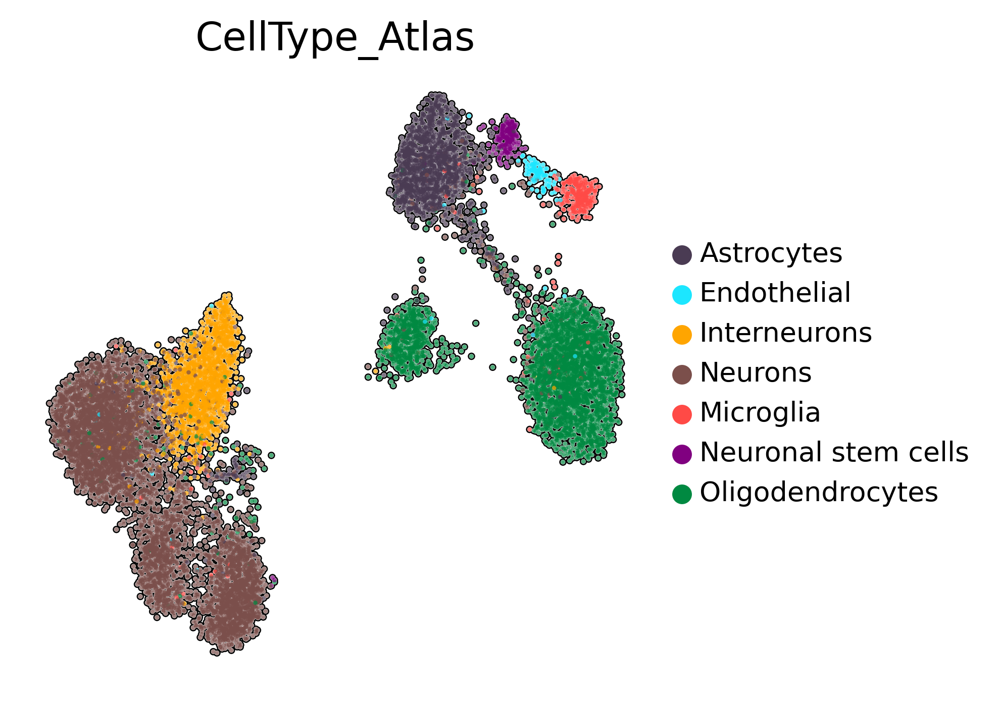

In [13]:
sc.pl.umap(adata, color=['CellType_Atlas'], add_outline=True, 
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False)

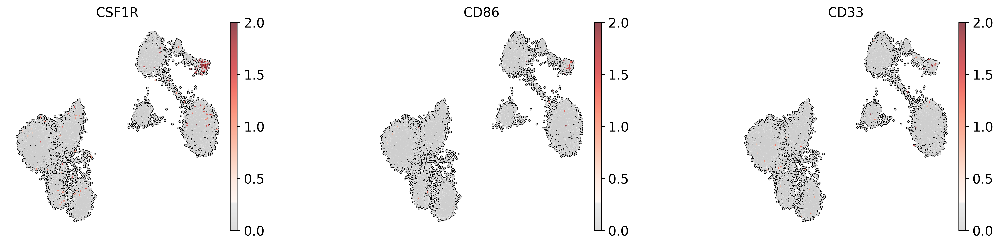

In [14]:
sc.pl.umap(adata, color=['CSF1R','CD86','CD33'], add_outline=True, 
           use_raw=False, wspace=0.5, legend_fontsize='x-small',color_map=mymap,frameon=False, vmax=2)

In [15]:
#subsample 1500 Neurons and 1500 Oligodendrocytes
x_samp=adata.obs_names[np.isin(adata.obs['CellType_Atlas'],['Neurons'])]
x_samp=np.random.choice(x_samp,1500,replace=False)
x_obs=list(x_samp)+list(adata.obs_names[np.isin(adata.obs['CellType_Atlas'],['Astrocytes', 'Endothelial', 
                                                                             'Interneurons', 'Microglia',
                                                                             'Neuronal stem cells', 'Oligodendrocytes'])])
adata_sub=adata[x_obs].copy()



x_samp=adata_sub.obs_names[np.isin(adata_sub.obs['CellType_Atlas'],['Oligodendrocytes'])]
x_samp=np.random.choice(x_samp,1500,replace=False)
x_obs=list(x_samp)+list(adata_sub.obs_names[np.isin(adata_sub.obs['CellType_Atlas'],['Astrocytes', 'Endothelial', 
                                                                                     'Interneurons', 'Neurons', 
                                                                                     'Microglia','Neuronal stem cells'])])
adata_sub=adata_sub[x_obs].copy()

In [16]:
adata_sub.obs.CellType_Atlas.value_counts()

Interneurons           1629
Astrocytes             1537
Neurons                1500
Oligodendrocytes       1500
Microglia               306
Neuronal stem cells     178
Endothelial             121
Name: CellType_Atlas, dtype: int64

In [17]:
adata_sub.uns['CellType_Atlas_colors']=['#4A3B53','#1CE6FF','orange','#7B4F4B','#FF4A46','purple','#008941','purple']

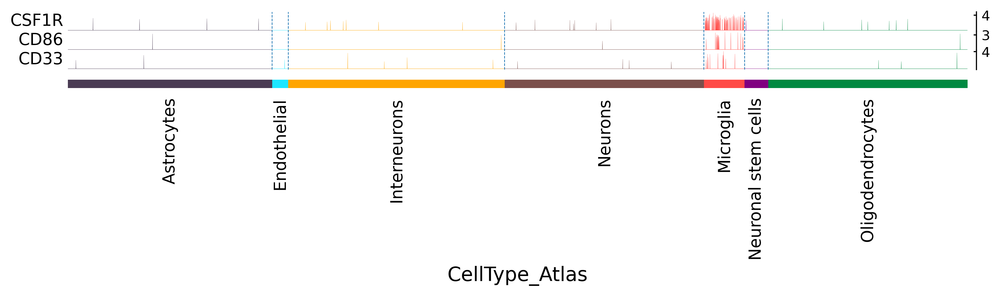

In [18]:
sc.pl.tracksplot(adata_sub, var_names=['CSF1R','CD86','CD33'], 
                 groupby='CellType_Atlas', cmap='Reds', standard_scale='var')

# Target candidate expression in mouse microglia

For the brain dataset of Habib, processed data was obtained from the original study (https://doi.org/10.1038/nmeth.4407), barcodes were filtered according to the annotated metadata

In [217]:
adata=sc.read(writepath + 'habib2017_mouse_filtered.h5ad')

In [219]:
sc.pp.calculate_qc_metrics(adata, inplace=True)

In [220]:
# FILTER PARAMETERS
print('Total number of cells: {:d}'.format(adata.n_obs))

#Filter cells with genes over 5500
sc.pp.filter_cells(adata, max_genes = 4000)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 13313
filtered out 131 cells that have more than 4000 genes expressed
Number of cells after gene filter: 13182


In [221]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out low count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 17308
filtered out 1629 genes that are detected in less than 20 cells
Number of genes after cell filter: 15679


In [223]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [225]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)


In [226]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:04)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:11)


In [34]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['Cluster'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['ASC1', 'ASC2', 'ChP', 'Doublets', 'END', 'GABA1', 'GABA2', 'MG', 'ODC',
       'OPC', 'SMC', 'Unclassified1', 'Unclassified2', 'Unclassified3',
       'exCA1', 'exCA3', 'exDG', 'exPFC1', 'exPFC2', 'exPFC3', 'exPFC4',
       'exPFC5', 'exPFC6', 'exPFC7', 'exPFC8', 'exPFC9'],
      dtype='object')

In [35]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['ASC1', 'ASC2', 'ChP', 'Doublets', 'END', 'GABA1', 'GABA2', 'MG', 'ODC',
       'OPC', 'SMC', 'Unclassified1', 'Unclassified2', 'Unclassified3',
       'exCA1', 'exCA3', 'exDG', 'exPFC1', 'exPFC2', 'exPFC3', 'exPFC4',
       'exPFC5', 'exPFC6', 'exPFC7', 'exPFC8', 'exPFC9'])

In [36]:
ix=np.isin(ref_cluster,['ASC2'])
ref_cluster[ix]='ASC1'

ix=np.isin(ref_cluster,['Doublets'])
ref_cluster[ix]='ChP'

ix=np.isin(ref_cluster,['GABA2'])
ref_cluster[ix]='GABA1'

ix=np.isin(ref_cluster,['OPC'])
ref_cluster[ix]='ODC'

ix=np.isin(ref_cluster,['OPC'])
ref_cluster[ix]='ODC'

ix=np.isin(ref_cluster,['Unclassified2','Unclassified3'])
ref_cluster[ix]='Unclassified1'

ix=np.isin(ref_cluster,['exCA3', 'exDG', 'exPFC1', 'exPFC2', 'exPFC3', 'exPFC4',
       'exPFC5', 'exPFC6', 'exPFC7', 'exPFC8', 'exPFC9'])
ref_cluster[ix]='exCA1'

In [37]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['ASC1', 'ChP', 'END', 'GABA1', 'MG', 'ODC','SMC', 
                                                       'Unclassified1', 'exCA1'])

In [39]:
adata.rename_categories('CellType_Atlas', ['Astrocytes', 'Remove', 'Endothelial', 'Interneurons',
                                           'Microglia', 'Oligodendrocytes', 'Smooth muscle', 'Unknown','Neurons'])

In [20]:
adata.obs.CellType_Atlas.cat.categories

Index(['Astrocytes', 'Remove', 'Endothelial', 'Interneurons', 'Microglia',
       'Oligodendrocytes', 'Smooth muscle', 'Unknown', 'Neurons'],
      dtype='object')

In [21]:
# remove unknown cluster
ix=np.isin(adata.obs['CellType_Atlas'],['Astrocytes', 'Endothelial', 'Interneurons', 'Microglia',
       'Oligodendrocytes', 'Smooth muscle', 'Neurons']) 
adata=adata[ix].copy()

In [22]:
# Calculate the visualizations
sc.pp.neighbors(adata)
sc.tl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


In [23]:
adata.uns['CellType_Atlas_colors']=['#4A3B53','#1CE6FF','orange','#FF4A46','#008941','#006FA6','#7B4F4B']

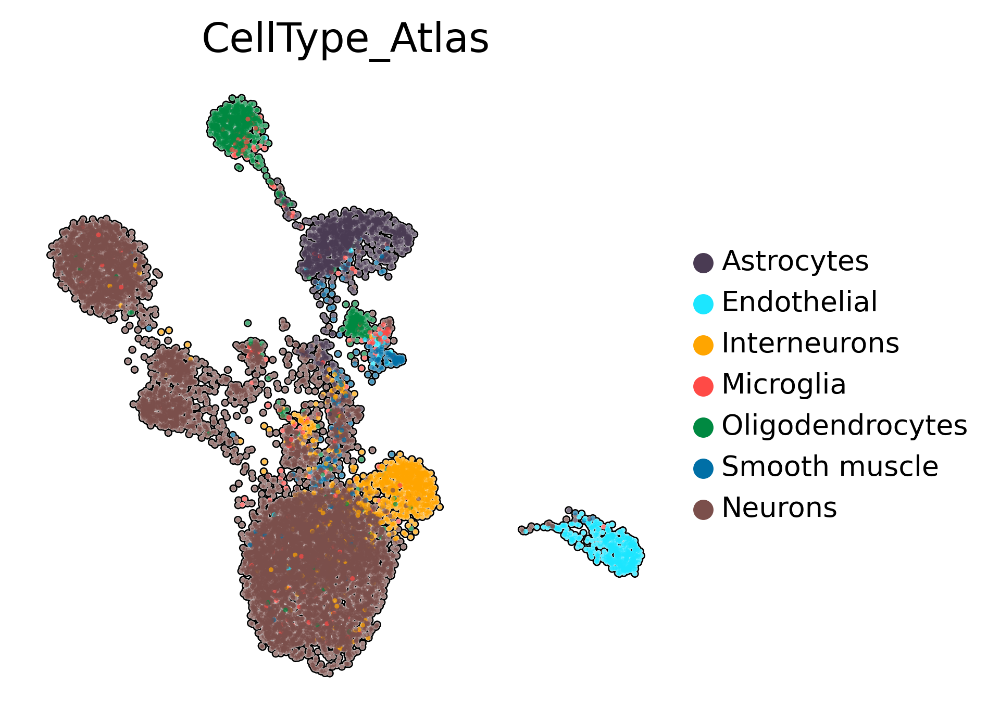

In [24]:
sc.pl.umap(adata, color=['CellType_Atlas'], add_outline=True, 
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False)

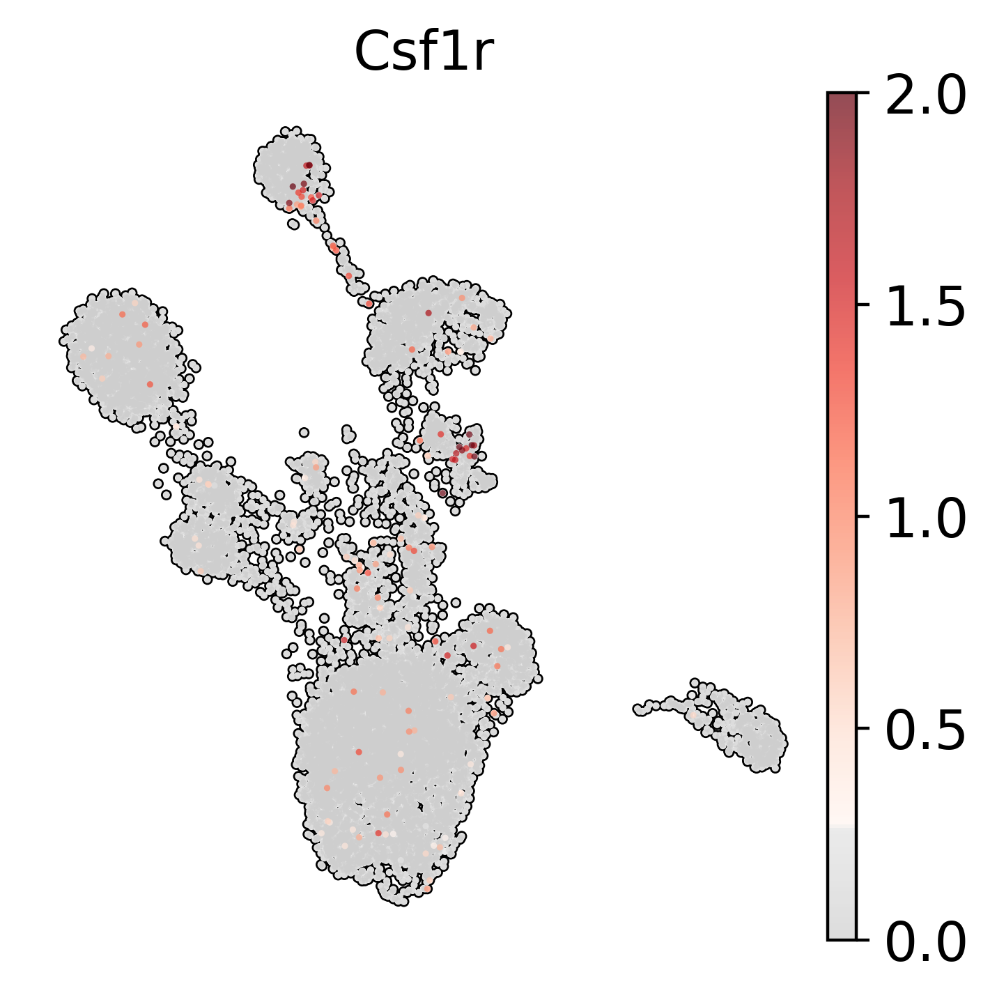

In [27]:
sc.pl.umap(adata, color=['Csf1r'], add_outline=True, 
           use_raw=False, wspace=0.5, legend_fontsize='x-small',color_map=mymap,frameon=False, vmax=2)

In [28]:
np.isin('Cd86', adata.var.index)

array(False)

In [30]:
#subsample 900 Neurons
x_samp=adata.obs_names[np.isin(adata.obs['CellType_Atlas'],['Neurons'])]
x_samp=np.random.choice(x_samp,900,replace=False)
x_obs=list(x_samp)+list(adata.obs_names[np.isin(adata.obs['CellType_Atlas'],['Astrocytes', 'Endothelial', 
                                                                             'Interneurons', 'Microglia',
                                                                             'Oligodendrocytes', 'Smooth muscle'])])
adata_sub=adata[x_obs].copy()

In [31]:
adata_sub.obs.CellType_Atlas.value_counts()

Astrocytes          948
Neurons             900
Interneurons        812
Oligodendrocytes    688
Endothelial         387
Microglia           207
Smooth muscle       183
Name: CellType_Atlas, dtype: int64

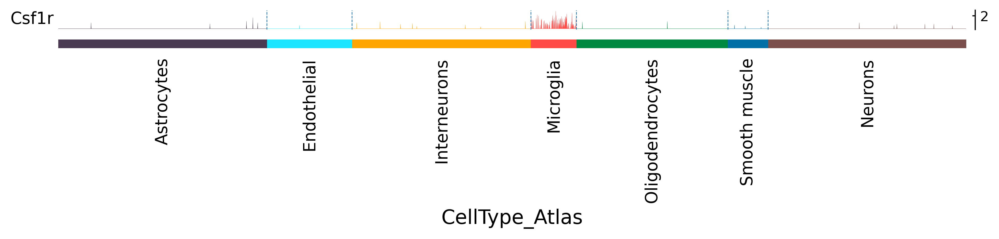

In [32]:
sc.pl.tracksplot(adata_sub, var_names='Csf1r', groupby='CellType_Atlas', cmap='Reds', standard_scale='var')

In [ ]:
adata.write(writepath + 'habib2017_mouse_processed.h5ad')

# Heart

## Han

In [150]:
ds = sfaira.data.human.DatasetGroupHeart(path=datadir)  # This links all data sets available

In [176]:
ds.ids

['human_heart_2020_microwell_han_001_10.1038/s41586-020-2157-4',
 'human_heart_2020_microwell_han_002_10.1038/s41586-020-2157-4',
 'human_heart_2020_microwell_han_003_10.1038/s41586-020-2157-4',
 'human_heart_2020_microwell_han_004_10.1038/s41586-020-2157-4']

In [177]:
# pick
idx = ds.ids[1]

In [178]:
idx

'human_heart_2020_microwell_han_002_10.1038/s41586-020-2157-4'

In [179]:
ds.datasets[idx].load()

/home/icb/moritz.thomas/miniconda3/lib/python3.7/site-packages/sfaira-master/sfaira/data/base.py:84: UserWarning: using default genomes Homo_sapiens_GRCh38_97
  warnings.warn(f"using default genomes {genome}")
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [180]:
print(ds.datasets[idx].adata)

AnnData object with n_obs × n_vars = 1478 × 27341
    obs: 'sample', 'sub_tissue', 'n_genes', 'n_counts', 'cluster_global', 'dev_stage', 'donor', 'celltype_global', 'age', 'celltype_specific', 'cluster_specific', 'gender', 'protocol', 'source', 'healthy', 'state_exact', 'cell_ontology_class', 'cell_ontology_id', 'organ'
    var: 'names', 'n_cells', 'ensembl'
    uns: 'lab', 'year', 'doi', 'protocol', 'organ', 'subtissue', 'animal', 'id', 'wget_download', 'has_celltypes', 'counts', 'dev_stage', 'mapped_features'


In [181]:
adata1=ds.datasets[idx].adata

In [183]:
# pick
idx = ds.ids[2]

In [184]:
idx

'human_heart_2020_microwell_han_003_10.1038/s41586-020-2157-4'

In [185]:
ds.datasets[idx].load()

/home/icb/moritz.thomas/miniconda3/lib/python3.7/site-packages/sfaira-master/sfaira/data/base.py:84: UserWarning: using default genomes Homo_sapiens_GRCh38_97
  warnings.warn(f"using default genomes {genome}")
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [186]:
print(ds.datasets[idx].adata)

AnnData object with n_obs × n_vars = 1308 × 27341
    obs: 'sample', 'sub_tissue', 'n_genes', 'n_counts', 'cluster_global', 'dev_stage', 'donor', 'celltype_global', 'age', 'celltype_specific', 'cluster_specific', 'gender', 'protocol', 'source', 'healthy', 'state_exact', 'cell_ontology_class', 'cell_ontology_id', 'organ'
    var: 'names', 'n_cells', 'ensembl'
    uns: 'lab', 'year', 'doi', 'protocol', 'organ', 'subtissue', 'animal', 'id', 'wget_download', 'has_celltypes', 'counts', 'dev_stage', 'mapped_features'


In [187]:
adata2=ds.datasets[idx].adata

In [192]:
adata=adata1.concatenate(adata2, batch_key='batch')

In [203]:
adata

AnnData object with n_obs × n_vars = 2786 × 27341
    obs: 'sample', 'sub_tissue', 'n_genes', 'n_counts', 'cluster_global', 'dev_stage', 'donor', 'celltype_global', 'age', 'celltype_specific', 'cluster_specific', 'gender', 'protocol', 'source', 'healthy', 'state_exact', 'cell_ontology_class', 'cell_ontology_id', 'organ', 'batch'
    var: 'names', 'n_cells', 'ensembl'

In [246]:
adata.var.index=adata.var['names'].tolist()

In [249]:
adata.X=sp.sparse.csr_matrix.todense(adata.X)

In [258]:
# FILTER PARAMETERS
print('Total number of cells: {:d}'.format(adata.n_obs))

#Filter out cells with genes over 1000
sc.pp.filter_cells(adata, max_genes = 1000)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 2786
filtered out 33 cells that have more than 1000 genes expressed
Number of cells after gene filter: 2753


In [259]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out low count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 27341
filtered out 18573 genes that are detected in less than 20 cells
Number of genes after cell filter: 8768


In [260]:
adata

AnnData object with n_obs × n_vars = 2753 × 8768
    obs: 'sample', 'sub_tissue', 'n_genes', 'n_counts', 'cluster_global', 'dev_stage', 'donor', 'celltype_global', 'age', 'celltype_specific', 'cluster_specific', 'gender', 'protocol', 'source', 'healthy', 'state_exact', 'cell_ontology_class', 'cell_ontology_id', 'organ', 'batch'
    var: 'names', 'n_cells', 'ensembl'

In [262]:
adata_pp=adata.copy()

In [263]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    with n_comps=15
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)


In [264]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [265]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [266]:
#Delete adata_pp
del adata_pp
adata.obs['size_factors'] = size_factors

In [267]:
adata.strings_to_categoricals()

In [270]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [271]:
adata.raw = adata

In [272]:
#Normalize data

adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [274]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [277]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)


In [278]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


In [207]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['celltype_specific'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['Apoptotic cell', 'Cardiomyocyte', 'Conventional dendritic cell',
       'Dendritic cell', 'Endothelial cell', 'Fibroblast', 'M1 Macrophage',
       'M2 Macrophage', 'Macrophage', 'Mast cell', 'Neutrophil',
       'Smooth muscle cell', 'T cell', 'Vascular endothelial cell',
       'Ventricle cardiomyocyte'],
      dtype='object')

In [208]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['Apoptotic cell', 'Cardiomyocyte', 'Conventional dendritic cell',
       'Dendritic cell', 'Endothelial cell', 'Fibroblast', 'M1 Macrophage',
       'M2 Macrophage', 'Macrophage', 'Mast cell', 'Neutrophil',
       'Smooth muscle cell', 'T cell', 'Vascular endothelial cell',
       'Ventricle cardiomyocyte'])

In [209]:
ix=np.isin(ref_cluster,['Ventricle cardiomyocyte'])
ref_cluster[ix]='Cardiomyocyte'

ix=np.isin(ref_cluster,['Dendritic cell'])
ref_cluster[ix]='Conventional dendritic cell'

ix=np.isin(ref_cluster,['Vascular endothelial cell'])
ref_cluster[ix]='Endothelial cell'

ix=np.isin(ref_cluster,[ 'M2 Macrophage', 'Macrophage'])
ref_cluster[ix]='M1 Macrophage',

In [210]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['Apoptotic cell', 'Cardiomyocyte', 'Conventional dendritic cell',
    'Endothelial cell', 'Fibroblast', 'M1 Macrophage',
        'Mast cell', 'Neutrophil',
       'Smooth muscle cell', 'T cell'])

In [211]:
adata.obs['CellType_Atlas'].cat.categories

Index(['Apoptotic cell', 'Cardiomyocyte', 'Conventional dendritic cell',
       'Endothelial cell', 'Fibroblast', 'M1 Macrophage', 'Mast cell',
       'Neutrophil', 'Smooth muscle cell', 'T cell'],
      dtype='object')

In [212]:
adata.rename_categories('CellType_Atlas', ['Remove', 'Cardiomyocyte', 'Dendritics',
       'Endothelial', 'Fibroblasts', 'Macrophages', 'Mast','Neutrophils', 'Smooth muscle', 'T cells'])

In [453]:
adata.write(writepath + 'han2020_processed.h5ad')

# Liver

## MacParland

In [204]:
ds = sfaira.data.human.DatasetGroupLiver(path=datadir)  # This links all data sets available

In [205]:
ds.ids 

['human_liver_2018_10x_macparland_001_10.1038/s41467-018-06318-7',
 'human_liver_2019_10x_popescu_001_10.1038/s41586-019-1652-y',
 'human_liver_2019_10x_ramachandran_001_10.1038/s41586-019-1631-3',
 'human_liver_2019_mCELSeq2_aizarani_001_10.1038/s41586-019-1373-2',
 'human_liver_2020_microwell_han_001_10.1038/s41586-020-2157-4',
 'human_liver_2020_microwell_han_002_10.1038/s41586-020-2157-4',
 'human_liver_2020_microwell_han_003_10.1038/s41586-020-2157-4',
 'human_liver_2020_microwell_han_004_10.1038/s41586-020-2157-4',
 'human_liver_2020_microwell_han_005_10.1038/s41586-020-2157-4']

In [206]:
# pick first one
idx = ds.ids[0]

In [212]:
idx

'human_liver_2018_10x_macparland_001_10.1038/s41467-018-06318-7'

In [207]:
ds.datasets[idx].load()

/home/icb/moritz.thomas/miniconda3/lib/python3.7/site-packages/sfaira-master/sfaira/data/base.py:84: UserWarning: using default genomes Homo_sapiens_GRCh38_97
  warnings.warn(f"using default genomes {genome}")


In [208]:
print(ds.datasets[idx].adata)

AnnData object with n_obs × n_vars = 8444 × 20007
    obs: 'cell_ontology_class', 'healthy', 'state_exact', 'cell_ontology_id'
    var: 'names', 'ensembl'
    uns: 'lab', 'year', 'doi', 'protocol', 'organ', 'subtissue', 'animal', 'id', 'wget_download', 'has_celltypes', 'counts', 'mapped_features'


In [209]:
adata=ds.datasets[idx].adata

In [216]:
adata.var.index=np.array(adata.var.names)

In [283]:
adata

AnnData object with n_obs × n_vars = 8444 × 20007
    obs: 'cell_ontology_class', 'healthy', 'state_exact', 'cell_ontology_id'
    var: 'names', 'ensembl'
    uns: 'animal', 'counts', 'doi', 'has_celltypes', 'id', 'lab', 'organ', 'protocol', 'subtissue', 'wget_download', 'year'

In [284]:
sc.pp.calculate_qc_metrics(adata, inplace=True)

In [285]:
adata.var_names[[gene.startswith('MT-') for gene in adata.var_names]]

Index(['MT-ND1', 'MT-ND2', 'MT-CO1', 'MT-CO2', 'MT-ATP8', 'MT-ATP6', 'MT-CO3',
       'MT-ND3', 'MT-ND4L', 'MT-ND4', 'MT-ND5', 'MT-ND6', 'MT-CYB'],
      dtype='object')

In [286]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata.var_names]
adata.obs['mt_frac'] = adata.X[:, mt_gene_mask].sum(1)/adata.obs['total_counts']

In [287]:
# FILTER PARAMETERS
print('Total number of cells: {:d}'.format(adata.n_obs))

#Filter out counts over 25000
sc.pp.filter_cells(adata, max_counts = 25000)
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

#MT filter
adata = adata[adata.obs['mt_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

#Filter out genes over 4000
sc.pp.filter_cells(adata, max_genes = 4000)
#print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 8444
filtered out 94 cells that have more than 25000 counts
Number of cells after max count filter: 8350
Number of cells after MT filter: 6289
filtered out 18 cells that have more than 4000 genes expressed


Trying to set attribute `.obs` of view, copying.


In [289]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out low count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 20007
filtered out 5140 genes that are detected in less than 20 cells
Number of genes after cell filter: 14867


In [292]:
adata.X

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [293]:
adata_pp=adata.copy()

In [294]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    with n_comps=15
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 15 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)


In [295]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [296]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [297]:
#Delete adata_pp
del adata_pp
adata.obs['size_factors'] = size_factors

In [298]:
adata.strings_to_categoricals()

In [300]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [301]:
adata.raw = adata

In [302]:
#Normalize data

adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [303]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [306]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)


In [307]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:13)


In [130]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['cell_ontology_class'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['Alpha beta T cells', 'Central venous LSECs', 'Cholangiocytes',
       'Endothelial cell', 'Erythroid cells', 'Gamma delta T cells 1',
       'Gamma delta T cells 2', 'Hepatic stellate cells', 'Hepatocyte 1',
       'Hepatocyte 2', 'Hepatocyte 3', 'Hepatocyte 4', 'Hepatocyte 5',
       'Hepatocyte 6', 'Inflammatory macrophages', 'Mature B cells', 'NK cell',
       'Non inflammatory macrophages', 'Periportal LSECs', 'Plasma cells'],
      dtype='object')

In [131]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['Alpha beta T cells', 'Central venous LSECs', 'Cholangiocytes',
       'Endothelial cell', 'Erythroid cells', 'Gamma delta T cells 1',
       'Gamma delta T cells 2', 'Hepatic stellate cells', 'Hepatocyte 1',
       'Hepatocyte 2', 'Hepatocyte 3', 'Hepatocyte 4', 'Hepatocyte 5',
       'Hepatocyte 6', 'Inflammatory macrophages', 'Mature B cells', 'NK cell',
       'Non inflammatory macrophages', 'Periportal LSECs', 'Plasma cells'])

In [132]:
ix=np.isin(ref_cluster,['Gamma delta T cells 1','Gamma delta T cells 2'])
ref_cluster[ix]='Alpha beta T cells'

ix=np.isin(ref_cluster,['Endothelial cell','Periportal LSECs'])
ref_cluster[ix]='Central venous LSECs'

ix=np.isin(ref_cluster,['Hepatocyte 2', 'Hepatocyte 3', 'Hepatocyte 4', 'Hepatocyte 5','Hepatocyte 6'])
ref_cluster[ix]='Hepatocyte 1'

ix=np.isin(ref_cluster,['Non inflammatory macrophages'])
ref_cluster[ix]='Inflammatory macrophages'

ix=np.isin(ref_cluster,['Plasma cells'])
ref_cluster[ix]='Mature B cells'

In [133]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['Alpha beta T cells', 'Central venous LSECs', 'Cholangiocytes',
      'Erythroid cells', 'Hepatic stellate cells', 'Hepatocyte 1',
      'Inflammatory macrophages', 'Mature B cells', 'NK cell'])

In [134]:
adata.obs['CellType_Atlas'].cat.categories

Index(['Alpha beta T cells', 'Central venous LSECs', 'Cholangiocytes',
       'Erythroid cells', 'Hepatic stellate cells', 'Hepatocyte 1',
       'Inflammatory macrophages', 'Mature B cells', 'NK cell'],
      dtype='object')

In [135]:
adata.rename_categories('CellType_Atlas', ['T cells', 'Endothelial', 'Epithelial',
       'Erythroid', 'Hepatic stellate', 'Hepatocytes',
       'Macrophages', 'B cells', 'NK cells'])

In [52]:
adata.write(writepath + 'macparland2018_processed.h5ad')

## Ramachandran

In [204]:
ds = sfaira.data.human.DatasetGroupLiver(path=datadir)  # This links all data sets available

In [205]:
ds.ids 

['human_liver_2018_10x_macparland_001_10.1038/s41467-018-06318-7',
 'human_liver_2019_10x_popescu_001_10.1038/s41586-019-1652-y',
 'human_liver_2019_10x_ramachandran_001_10.1038/s41586-019-1631-3',
 'human_liver_2019_mCELSeq2_aizarani_001_10.1038/s41586-019-1373-2',
 'human_liver_2020_microwell_han_001_10.1038/s41586-020-2157-4',
 'human_liver_2020_microwell_han_002_10.1038/s41586-020-2157-4',
 'human_liver_2020_microwell_han_003_10.1038/s41586-020-2157-4',
 'human_liver_2020_microwell_han_004_10.1038/s41586-020-2157-4',
 'human_liver_2020_microwell_han_005_10.1038/s41586-020-2157-4']

In [224]:
# pick
idx = ds.ids[2]

In [225]:
idx

'human_liver_2019_10x_ramachandran_001_10.1038/s41586-019-1631-3'

In [226]:
ds.datasets[idx].load()

In [227]:
print(ds.datasets[idx].adata)

AnnData object with n_obs × n_vars = 58358 × 23498
    obs: 'nGene', 'nUMI', 'percent.mito', 'dataset', 'liver', 'condition', 'aetiology', 'annotation_original', 'annotation_indepth', 'annotation_lineage', 'ident', 'cell_ontology_class', 'healthy', 'state_exact', 'cell_ontology_id'
    var: 'names', 'ensembl'
    uns: 'lab', 'year', 'doi', 'protocol', 'organ', 'subtissue', 'animal', 'id', 'wget_download', 'has_celltypes', 'counts', 'mapped_features'
    layers: 'logcounts'


In [228]:
adata=ds.datasets[idx].adata

In [233]:
ix=np.isin(adata.obs['aetiology'],['Uninjured']) 
adata=adata[ix].copy()

In [242]:
adata.var.index=np.array(adata.var.names)

In [311]:
sc.pp.calculate_qc_metrics(adata, inplace=True)

In [312]:
adata.var_names[[gene.startswith('MT-') for gene in adata.var_names]]

Index(['MT-ND1', 'MT-ND2', 'MT-CO1', 'MT-CO2', 'MT-ATP8', 'MT-ATP6', 'MT-CO3',
       'MT-ND3', 'MT-ND4L', 'MT-ND4', 'MT-ND5', 'MT-ND6', 'MT-CYB'],
      dtype='object')

In [313]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata.var_names]

In [314]:
testdf=pd.DataFrame(adata.X[:, mt_gene_mask].sum(1))
testdf.columns=['sum']
testdf['total_counts']=adata.obs['total_counts'].values
testdf['mt_frac']=testdf['sum']/testdf['total_counts']

In [318]:
adata.obs['mt_frac']=np.array(testdf['mt_frac'])

In [320]:
# FILTER PARAMETERS
print('Total number of cells: {:d}'.format(adata.n_obs))

#Filter out counts over 25000
sc.pp.filter_cells(adata, max_counts = 25000)
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

#MT filter
adata = adata[adata.obs['mt_frac'] < 20]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

#Filter out genes over 4000
sc.pp.filter_cells(adata, max_genes = 4000)
#print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 33628
filtered out 242 cells that have more than 25000 counts
Number of cells after max count filter: 33386
Number of cells after MT filter: 33136
filtered out 99 cells that have more than 4000 genes expressed


Trying to set attribute `.obs` of view, copying.


In [322]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out low count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 23498
filtered out 5129 genes that are detected in less than 20 cells
Number of genes after cell filter: 18369


In [323]:
adata

AnnData object with n_obs × n_vars = 33037 × 18369
    obs: 'nGene', 'nUMI', 'percent.mito', 'dataset', 'liver', 'condition', 'aetiology', 'annotation_original', 'annotation_indepth', 'annotation_lineage', 'ident', 'cell_ontology_class', 'healthy', 'state_exact', 'cell_ontology_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes'
    var: 'names', 'ensembl', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'animal', 'counts', 'doi', 'has_celltypes', 'id', 'lab', 'organ', 'protocol', 'subtissue', 'wget_download', 'year', 'liver_colors'
    layers: 'logcounts'

In [324]:
adata.X=sp.sparse.csr_matrix.todense(adata.X)

In [326]:
adata_pp=adata.copy()

In [327]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

normalizing by total count per cell
    finished (0:00:04): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    with n_comps=15
    finished (0:00:15)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 15 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:03)


In [328]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [329]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [330]:
#Deletstrings_to_categoricals_pp
del adata_pp
adata.obs['size_factors'] = size_factors

In [331]:
adata.strings_to_categoricals()

In [333]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [334]:
adata.raw = adata

In [335]:
#Normalize data

adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [336]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [339]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)


In [340]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:12)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:30)


In [141]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['annotation_indepth'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['MPs (1)', 'MPs (2)', 'MPs (3)', 'MPs (4)', 'MPs (5)', 'MPs (6)',
       'MPs (7)', 'MPs (8)', 'MPs (9)', 'Cycling MPs (1)', 'Cycling MPs (2)',
       'Cycling MPs (3)', 'Cycling MPs (4)', 'pDCs', 'ILCs (1)', 'ILCs (2)',
       'ILCs (3)', 'Cycling ILCs (1)', 'Cycling ILCs (2)', 'Tcells (1)',
       'Tcells (2)', 'Tcells (3)', 'Tcells (4)', 'Tcells (5)',
       'Cycling Tcells', 'Bcells (1)', 'Bcells (2)', 'Plasma Bcells (1)',
       'Plasma Bcells (2)', 'Mast cells', 'Endothelia (1)', 'Endothelia (2)',
       'Endothelia (3)', 'Endothelia (4)', 'Endothelia (5)', 'Endothelia (6)',
       'Endothelia (7)', 'Mesenchyme (1)', 'Mesenchyme (2)', 'Myofibroblasts',
       'Mesothelia', 'Hepatocytes', 'Cholangiocytes (1)', 'Cholangiocytes (2)',
       'Cholangiocytes (3)'],
      dtype='object')

In [142]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['MPs (1)', 'MPs (2)', 'MPs (3)', 'MPs (4)', 'MPs (5)', 'MPs (6)',
       'MPs (7)', 'MPs (8)', 'MPs (9)', 'Cycling MPs (1)', 'Cycling MPs (2)',
       'Cycling MPs (3)', 'Cycling MPs (4)', 'pDCs', 'ILCs (1)', 'ILCs (2)',
       'ILCs (3)', 'Cycling ILCs (1)', 'Cycling ILCs (2)', 'Tcells (1)',
       'Tcells (2)', 'Tcells (3)', 'Tcells (4)', 'Tcells (5)',
       'Cycling Tcells', 'Bcells (1)', 'Bcells (2)', 'Plasma Bcells (1)',
       'Plasma Bcells (2)', 'Mast cells', 'Endothelia (1)', 'Endothelia (2)',
       'Endothelia (3)', 'Endothelia (4)', 'Endothelia (5)', 'Endothelia (6)',
       'Endothelia (7)', 'Mesenchyme (1)', 'Mesenchyme (2)', 'Myofibroblasts',
       'Mesothelia', 'Hepatocytes', 'Cholangiocytes (1)', 'Cholangiocytes (2)',
       'Cholangiocytes (3)'])

In [143]:
ix=np.isin(ref_cluster,['MPs (2)', 'MPs (3)', 'MPs (4)', 'MPs (5)', 'MPs (6)',
       'MPs (7)', 'MPs (8)', 'MPs (9)', 'Cycling MPs (1)', 'Cycling MPs (2)',
       'Cycling MPs (3)', 'Cycling MPs (4)'])
ref_cluster[ix]='MPs (1)'


ix=np.isin(ref_cluster,['ILCs (1)', 'ILCs (2)','ILCs (3)', 'Cycling ILCs (1)', 'Cycling ILCs (2)'])
ref_cluster[ix]='pDCs'


ix=np.isin(ref_cluster,['Tcells (2)', 'Tcells (3)', 'Tcells (4)', 'Tcells (5)','Cycling Tcells'])
ref_cluster[ix]='Tcells (1)'

ix=np.isin(ref_cluster,['Bcells (2)', 'Plasma Bcells (1)','Plasma Bcells (2)'])
ref_cluster[ix]='Bcells (1)'

ix=np.isin(ref_cluster,['Endothelia (2)','Endothelia (3)', 'Endothelia (4)', 'Endothelia (5)', 
                        'Endothelia (6)','Endothelia (7)'])
ref_cluster[ix]='Endothelia (1)'

ix=np.isin(ref_cluster,['Mesenchyme (2)'])
ref_cluster[ix]= 'Mesenchyme (1)'

ix=np.isin(ref_cluster,['Cholangiocytes (2)','Cholangiocytes (3)'])
ref_cluster[ix]= 'Cholangiocytes (1)'

In [144]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['MPs (1)','pDCs', 'Tcells (1)','Bcells (1)', 
                                                       'Mast cells', 'Endothelia (1)','Mesenchyme (1)',
                                                       'Myofibroblasts','Mesothelia', 'Hepatocytes', 'Cholangiocytes (1)'])

In [145]:
adata.obs['CellType_Atlas'].cat.categories

Index(['MPs (1)', 'pDCs', 'Tcells (1)', 'Bcells (1)', 'Mast cells',
       'Endothelia (1)', 'Mesenchyme (1)', 'Myofibroblasts', 'Mesothelia',
       'Hepatocytes', 'Cholangiocytes (1)'],
      dtype='object')

In [146]:
adata.rename_categories('CellType_Atlas', ['Macrophages', 'Dendritics', 'T cells', 'B cells', 'Mast',
       'Endothelial', 'Mesenchymal', 'Lymphoid', 'Mesothelial',
       'Hepatocytes', 'Epithelial'])

In [ ]:
adata.write(writepath + 'ramachandran2019_processed.h5ad')

# Gut

## Colon - James

For the colon dataset of James, data was obtained from the original study (https://doi.org/10.1038/s41590-020-0602-z)

In [345]:
adata=sc.read(writepath + 'james2020_raw.h5ad')

In [346]:
adata

AnnData object with n_obs × n_vars = 41650 × 18927
    obs: 'donor', 'region', 'n_genes', 'percent_mito', 'n_counts', 'cell_type', 'BCR_ChainCombination', 'BCR_SEQUENCE_ID', 'IGH_V_CALL_GENOTYPED', 'IGH_D_CALL', 'IGH_J_CALL', 'BCR_ISOTYPE', 'BCR_CLONE', 'BCR_PANDONOR_CLONE', 'IGL_C_Gene', 'IGL_VDJ_Gene', 'IGH_READS', 'IGH_UMIS', 'IGH_MU_FREQ', 'IGK_READS', 'IGK_UMIS', 'IGL_READS', 'IGL_UMIS', 'TCR_v_gene', 'TCR_d_gene', 'TCR_j_gene', 'TCR_c_gene', 'TCR_cdr3', 'TCR_cdr3_nt', 'TCR_reads', 'TCR_umis', 'TCR_Clone'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'gene_ids', 'feature_types'
    uns: 'leiden', 'neighbors', 'pca', 'rank_genes_groups'
    obsm: 'X_umap'
    obsp: 'connectivities', 'distances'

In [347]:
sc.pp.calculate_qc_metrics(adata, inplace=True)

In [350]:
# FILTER PARAMETERS
print('Total number of cells: {:d}'.format(adata.n_obs))

#MT filter
adata = adata[adata.obs['percent_mito'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

#Filter out genes over 4000
sc.pp.filter_cells(adata, max_genes = 4000)
#print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 41650
Number of cells after MT filter: 41391
filtered out 70 cells that have more than 4000 genes expressed


Trying to set attribute `.obs` of view, copying.


In [351]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out low count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 18927
filtered out 3829 genes that are detected in less than 20 cells
Number of genes after cell filter: 15098


In [353]:
adata.X=sp.sparse.csr_matrix.todense(adata.X)

In [355]:
adata_pp=adata.copy()

In [356]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

normalizing by total count per cell
    finished (0:00:04): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    on highly variable genes
    with n_comps=15
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:06)


In [357]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [358]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [359]:
#Deletstrings_to_categoricals_pp
del adata_pp
adata.obs['size_factors'] = size_factors

In [361]:
adata.strings_to_categoricals()

In [363]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [364]:
adata.raw = adata

In [365]:
#Normalize data

adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [366]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [369]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:01)


In [370]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:17)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:40)


In [174]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['cell_type'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['Activated CD4 T', 'B cell IgA Plasma', 'B cell IgG Plasma',
       'B cell cycling', 'Follicular B cell', 'B cell memory', 'CD8 T', 'ILC',
       'Lymphoid DC', 'Monocyte', 'Mast', 'Macrophage', 'LYVE1 Macrophage',
       'NK', 'Tcm', 'Tfh', 'Th1', 'Th17', 'Treg', 'cDC1', 'cDC2',
       'cycling DCs', 'pDC', 'gd T', 'cycling gd T'],
      dtype='object')

In [175]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['Activated CD4 T', 'B cell IgA Plasma', 'B cell IgG Plasma',
       'B cell cycling', 'Follicular B cell', 'B cell memory', 'CD8 T', 'ILC',
       'Lymphoid DC', 'Monocyte', 'Mast', 'Macrophage', 'LYVE1 Macrophage',
       'NK', 'Tcm', 'Tfh', 'Th1', 'Th17', 'Treg', 'cDC1', 'cDC2',
       'cycling DCs', 'pDC', 'gd T', 'cycling gd T'])

In [176]:
ix=np.isin(ref_cluster,['CD8 T','Tcm', 'Tfh', 'Th1', 'Th17', 'Treg','gd T', 'cycling gd T'])
ref_cluster[ix]='Activated CD4 T'

ix=np.isin(ref_cluster,['B cell IgG Plasma','B cell cycling', 'Follicular B cell', 'B cell memory'])
ref_cluster[ix]='B cell IgA Plasma'

ix=np.isin(ref_cluster,['cDC1', 'cDC2','cycling DCs', 'pDC'])
ref_cluster[ix]='Lymphoid DC'

ix=np.isin(ref_cluster,['LYVE1 Macrophage'])
ref_cluster[ix]='Macrophage'

In [177]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['Activated CD4 T', 'B cell IgA Plasma', 'ILC',
       'Lymphoid DC', 'Monocyte', 'Mast', 'Macrophage','NK'])

In [178]:
adata.obs['CellType_Atlas'].cat.categories

Index(['Activated CD4 T', 'B cell IgA Plasma', 'ILC', 'Lymphoid DC',
       'Monocyte', 'Mast', 'Macrophage', 'NK'],
      dtype='object')

In [179]:
adata.rename_categories('CellType_Atlas', ['T cells', 'B cells', 'Innate Lymphoid', 'Dendritics',
       'Monocytes', 'Mast', 'Macrophages', 'NK cells'])

In [54]:
adata.write(writepath + 'james2020_processed.h5ad')

## Oesophagus - Madissoon

In [70]:
ds = sfaira.data.human.DatasetGroupEsophagus(path=datadir)  # This links all data sets available

In [71]:
ds.ids 

['human_esophagus_2019_10x_madissoon_001_10.1101/741405',
 'human_esophagus_2020_microwell_han_001_10.1038/s41586-020-2157-4',
 'human_esophagus_2020_microwell_han_002_10.1038/s41586-020-2157-4']

In [72]:
# pick first one
idx = ds.ids[0]

In [73]:
idx

'human_esophagus_2019_10x_madissoon_001_10.1101/741405'

In [74]:
ds.datasets[idx].load()

/home/icb/moritz.thomas/miniconda3/lib/python3.7/site-packages/sfaira-master/sfaira/data/base.py:84: UserWarning: using default genomes Homo_sapiens_GRCh38_97
  warnings.warn(f"using default genomes {genome}")


In [76]:
adata=ds.datasets[idx].adata

In [77]:
adata

AnnData object with n_obs × n_vars = 87947 × 24245
    obs: 'Donor', 'Time', 'donor_time', 'organ', 'patient', 'sample', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Celltypes', 'cell_ontology_class', 'healthy', 'state_exact', 'cell_ontology_id'
    var: 'names', 'ensembl', 'gene_ids-HCATisStab7413620', 'gene_ids-HCATisStab7413621', 'gene_ids-HCATisStab7413622', 'gene_ids-HCATisStab7587201', 'gene_ids-HCATisStab7587204', 'gene_ids-HCATisStab7587207', 'gene_ids-HCATisStab7587210', 'gene_ids-HCATisStab7619064', 'gene_ids-HCATisStab7619065', 'gene_ids-HCATisStab7619066', 'gene_ids-HCATisStab7619067', 'gene_ids-HCATisStab7646028', 'gene_ids-HCATisStab7646029', 'gene_ids-HCATisStab7646030', 'gene_ids-HCATisStab7646031', 'gene_ids-HCATisStabAug177184858', 'gene_ids-HCATisStabAug177184862', 'gene_ids-HCATisStabAug177184863', 'gene_ids-HCATisStabAug177376562', 'gene_ids-HCATisStabAug177376564', 'gene_ids-HCATisStabAug177376566', 'gene_ids-HCATisStabAug177376568', 'n_cells'
    uns: 'Cellt

In [81]:
adata.var.index=np.array(adata.var.names)

In [373]:
sc.pp.calculate_qc_metrics(adata, inplace=True)

In [375]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out low count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 24245
filtered out 4945 genes that are detected in less than 20 cells
Number of genes after cell filter: 19300


In [377]:
adata.X=sp.sparse.csr_matrix.todense(adata.X)

In [379]:
adata_pp=adata.copy()

In [380]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

normalizing by total count per cell
    finished (0:00:19): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    with n_comps=15
    finished (0:00:54)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 18 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:23)


In [381]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [382]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [383]:
#Deletstrings_to_categoricalsa_pp
del adata_pp
adata.obs['size_factors'] = size_factors

In [384]:
adata.strings_to_categoricals()

In [386]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [387]:
adata.raw = adata

In [388]:
#Normalize data

adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [389]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [392]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:01)


In [393]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:15)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:22)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:38)


In [185]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['cell_ontology_class'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['B_CD27neg', 'B_CD27pos', 'Basal cell', 'Blood_vessel',
       'Dendritic cell', 'Epi_dividing', 'Epi_suprabasal', 'Epi_upper',
       'Glands_duct', 'Glands_mucous', 'Lymph_vessel', 'Mast cell',
       'Mono_macro', 'NK_T_CD8_Cytotoxic', 'Stratified epithelial cell',
       'Stromal cell', 'T_CD4', 'T_CD8'],
      dtype='object')

In [186]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['B_CD27neg', 'B_CD27pos', 'Basal cell', 'Blood_vessel',
       'Dendritic cell', 'Epi_dividing', 'Epi_suprabasal', 'Epi_upper',
       'Glands_duct', 'Glands_mucous', 'Lymph_vessel', 'Mast cell',
       'Mono_macro', 'NK_T_CD8_Cytotoxic', 'Stratified epithelial cell',
       'Stromal cell', 'T_CD4', 'T_CD8'])

In [187]:
ix=np.isin(ref_cluster,['B_CD27pos'])
ref_cluster[ix]='B_CD27neg'

ix=np.isin(ref_cluster,['Lymph_vessel'])
ref_cluster[ix]= 'Blood_vessel'

ix=np.isin(ref_cluster,['Epi_suprabasal', 'Epi_upper','Stratified epithelial cell'])
ref_cluster[ix]='Epi_dividing'

ix=np.isin(ref_cluster,['Glands_mucous'])
ref_cluster[ix]='Glands_duct'

ix=np.isin(ref_cluster,[ 'T_CD4', 'T_CD8'])
ref_cluster[ix]='NK_T_CD8_Cytotoxic'

In [188]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['B_CD27neg', 'Basal cell', 'Blood_vessel',
       'Dendritic cell', 'Epi_dividing',
       'Glands_duct', 'Mast cell',
       'Mono_macro', 'NK_T_CD8_Cytotoxic',
       'Stromal cell'])

In [189]:
adata.obs['CellType_Atlas'].cat.categories

Index(['B_CD27neg', 'Basal cell', 'Blood_vessel', 'Dendritic cell',
       'Epi_dividing', 'Glands_duct', 'Mast cell', 'Mono_macro',
       'NK_T_CD8_Cytotoxic', 'Stromal cell'],
      dtype='object')

In [190]:
adata.rename_categories('CellType_Atlas', ['B cells', 'Basal', 'Endothelial', 'Dendritics',
       'Epithelial', 'Glands', 'Mast', 'Monocytes',
       'T cells', 'Stroma'])

In [92]:
adata.write(writepath + 'madissoon2019_colon_processed.h5ad')

# Skin

## Cheng

In [111]:
ds = sfaira.data.human.DatasetGroupSkin(path=datadir)  # This links all data sets available

In [112]:
ds.ids

['human_skin_2018_10x_cheng_001_10.1016/j.celrep.2018.09.006',
 'human_skin_2020_microwell_han_001_10.1038/s41586-020-2157-4',
 'human_skin_2020_microwell_han_002_10.1038/s41586-020-2157-4']

In [113]:
# pick first one
idx = ds.ids[0]

In [114]:
idx

'human_skin_2018_10x_cheng_001_10.1016/j.celrep.2018.09.006'

In [115]:
ds.datasets[idx].load()

/home/icb/moritz.thomas/miniconda3/lib/python3.7/site-packages/sfaira-master/sfaira/data/base.py:84: UserWarning: using default genomes Homo_sapiens_GRCh38_97
  warnings.warn(f"using default genomes {genome}")


In [116]:
print(ds.datasets[idx].adata)

AnnData object with n_obs × n_vars = 68036 × 19791
    obs: 'sample', 'tissue', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'CellType', 'Re-annotation', 'cell_ontology_class', 'healthy', 'state_exact', 'cell_ontology_id'
    var: 'names', 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'n_genes', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'ensembl'
    uns: 'leiden', 'neighbors_hm', 'pca', 'lab', 'year', 'doi', 'protocol', 'organ', 'subtissue', 'animal', 'id', 'wget_download', 'has_celltypes', 'counts', 'mapped_features'
    obsm: 'X_umap_hm'
    varm: 'PCs'


In [117]:
adata=ds.datasets[idx].adata

In [121]:
adata.var.index=np.array(adata.var.names)

In [396]:
sc.pp.calculate_qc_metrics(adata, inplace=True)

In [397]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 20 cells - filters out low count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 19791
filtered out 424 genes that are detected in less than 20 cells
Number of genes after cell filter: 19367


In [399]:
adata.X=sp.sparse.csr_matrix.todense(adata.X)

In [401]:
adata_pp=adata.copy()

In [402]:
#Perform a clustering for scran normalization in clusters
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

normalizing by total count per cell


/home/moritz.thomas/.local/lib/python3.7/site-packages/anndata/compat/__init__.py:216: FutureWarning: During AnnData slicing, found matrix at .uns['neighbors_hm']['connectivities'] that happens to be dimensioned at n_obs×n_obs (68036×68036).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  FutureWarning,
/home/moritz.thomas/.local/lib/python3.7/site-packages/anndata/compat/__init__.py:216: FutureWarning: During AnnData slicing, found matrix at .uns['neighbors_hm']['distances'] that happens to be dimensioned at n_obs×n_obs (68036×68036).

These matrices should now be stored in the .obsp attribute.
This slicing behavior will be removed in anndata 0.8.
  FutureWarning,


    finished (0:00:09): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
computing PCA
    on highly variable genes
    with n_comps=15
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:16)


In [403]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [404]:
%%R -i data_mat -i input_groups -o size_factors
require(scran)

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

In [405]:
#Deletstrings_to_categoricals_pp
del adata_pp
adata.obs['size_factors'] = size_factors

In [406]:
adata.strings_to_categoricals()

In [408]:
#make  (adata.X) copy of counts of raw data for downstream analysis

#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [409]:
adata.raw = adata

In [410]:
#Normalize data

adata.X /= adata.obs['size_factors'].values[:, None]
sc.pp.log1p(adata)

In [411]:
adata.X = sp.sparse.csr_matrix(adata.X)

In [414]:
# extract highly variable genes
sc.pp.filter_genes_dispersion(adata, flavor='cell_ranger', 
                              n_top_genes=4000, log=False, subset=False)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)


In [415]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:14)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:18)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:23)


In [196]:
# make consistent annotations across datasets
adata.obs['CellType_Atlas']=adata.obs['cell_ontology_class'].copy()
adata.obs['CellType_Atlas'].cat.categories

Index(['Basal cell 1', 'Basal cell 2', 'WNT1', 'channel', 'folicular',
       'granular', 'immune', 'melanocyte', 'mitotic', 'spinous'],
      dtype='object')

In [197]:
ref_cluster=pd.Categorical(adata.obs['CellType_Atlas'],
                           categories=['Basal cell 1', 'Basal cell 2', 'WNT1', 'channel', 'folicular',
       'granular', 'immune', 'melanocyte', 'mitotic', 'spinous'])

In [198]:
ix=np.isin(ref_cluster,['Basal cell 2'])
ref_cluster[ix]='Basal cell 1'

ix=np.isin(ref_cluster,['channel', 'folicular','granular', 'mitotic', 'spinous'])
ref_cluster[ix]='WNT1'

In [199]:
adata.obs['CellType_Atlas']=pd.Categorical(ref_cluster,
                                           categories=['Basal cell 1', 'WNT1', 'immune', 'melanocyte'])

In [200]:
adata.obs['CellType_Atlas'].cat.categories

Index(['Basal cell 1', 'WNT1', 'immune', 'melanocyte'], dtype='object')

In [201]:
adata.rename_categories('CellType_Atlas', ['Basal', 'Keratinocytes', 'Monocytes', 'Melanocyte'])

In [183]:
adata.write(writepath + 'cheng2018_processed.h5ad')

# UMAP plots

# Brain

## Habib - Human

In [11]:
habib=sc.read(writepath + 'habib2017_human_processed.h5ad')

/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [13]:
# remove unknown cluster
ix=np.isin(habib.obs['CellType_Atlas'],['Astrocytes', 'Endothelial', 'Interneurons', 'Neurons', 'Microglia',
       'Neuronal stem cells', 'Oligodendrocytes']) 
habib=habib[ix].copy()

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [14]:
# Calculate the visualizations
sc.pp.neighbors(habib)
sc.tl.umap(habib)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:15)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:11)


In [15]:
habib.obs.CellType_Atlas.cat.categories

Index(['Astrocytes', 'Endothelial', 'Interneurons', 'Neurons', 'Microglia',
       'Neuronal stem cells', 'Oligodendrocytes'],
      dtype='object')

In [16]:
habib.uns['CellType_Atlas_colors']=['#4A3B53','#1CE6FF','orange','#7B4F4B','#FF4A46','purple','#008941','purple']

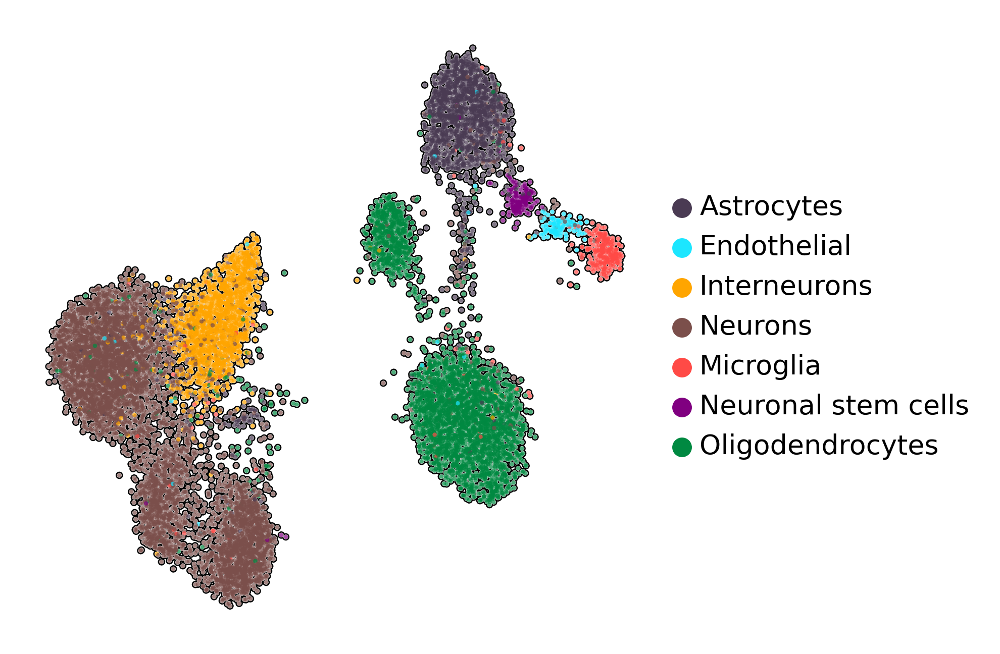

In [18]:
sc.pl.umap(habib, color=['CellType_Atlas'], add_outline=True, 
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

# Lung

## Travaglini

In [14]:
travaglini=sc.read(writepath + 'travaglini2020_processed.h5ad')

In [15]:
travaglini.obs['CellType_Atlas'].cat.categories

Index(['Mesothelial', 'Smooth muscle', 'Alveolar', 'Arterial', 'B cells',
       'Basal', 'Bronchial', 'Capillary', 'Dendritics', 'Fibroblasts',
       'Innate Lymphoid', 'Endothelial', 'Macrophages', 'Mast',
       'Megakaryocytes', 'Monocytes', 'Multiciliated', 'Lymphoid', 'Remove',
       'Secretory', 'T cells', 'Venous'],
      dtype='object')

In [16]:
# remove clusters
ix=np.isin(travaglini.obs['CellType_Atlas'],['Mesothelial', 'Smooth muscle', 'Alveolar', 'Arterial', 'B cells',
       'Basal', 'Bronchial', 'Capillary', 'Dendritics', 'Fibroblasts',
       'Innate Lymphoid', 'Endothelial', 'Macrophages', 'Mast',
       'Megakaryocytes', 'Monocytes', 'Multiciliated', 'Lymphoid',
       'Secretory', 'T cells', 'Venous']) 
travaglini=travaglini[ix].copy()

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [18]:
bbknn.bbknn(travaglini, batch_key='donor')

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:06)


In [19]:
sc.tl.umap(travaglini)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:45)


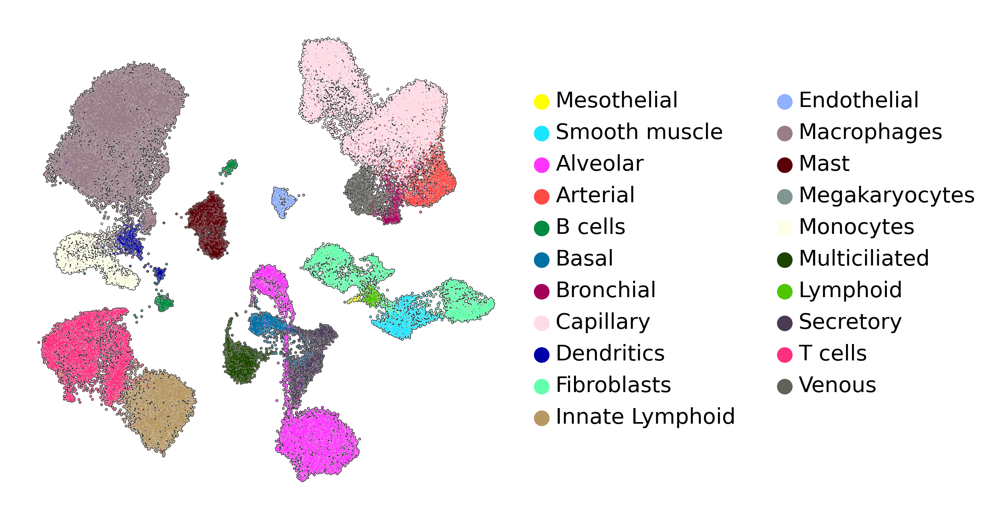

In [166]:
sc.pl.umap(travaglini, color=['CellType_Atlas'], add_outline=True, 
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

In [163]:
color=pd.DataFrame()
color['celltype']=travaglini.obs.CellType_Atlas.cat.categories
color['color']=travaglini.uns['CellType_Atlas_colors']

In [164]:
# add manually
new_row1 = {'celltype':'Epithelial', 'color':'#735510'}
new_row2 = {'celltype':'Stroma', 'color':'#4138eb'}
new_row4 = {'celltype':'NK cells', 'color':'#e8c268'}

#append row to the dataframe
color = color.append(new_row1, ignore_index=True)
color = color.append(new_row2, ignore_index=True)
color = color.append(new_row3, ignore_index=True)
color = color.append(new_row4, ignore_index=True)

In [165]:
color

,celltype,color
0,Mesothelial,#ffff00
1,Smooth muscle,#1ce6ff
2,Alveolar,#ff34ff
3,Arterial,#ff4a46
4,B cells,#008941
5,Basal,#006fa6
6,Bronchial,#a30059
7,Capillary,#ffdbe5
8,Dendritics,#0000a6
9,Fibroblasts,#63ffac


## Madissoon

In [12]:
madissoon=sc.read(writepath + 'madissoon2020_lung_processed.h5ad')

/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [167]:
current_cells=np.array(madissoon.obs['CellType_Atlas'].cat.categories)
df_tmp = color.set_index('celltype').loc[current_cells].reset_index(inplace=False)
current_colors=np.array(df_tmp['color'])
madissoon.uns['CellType_Atlas_colors']=current_colors

In [31]:
bbknn.bbknn(madissoon, batch_key='donor')
sc.tl.umap(madissoon)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:53)


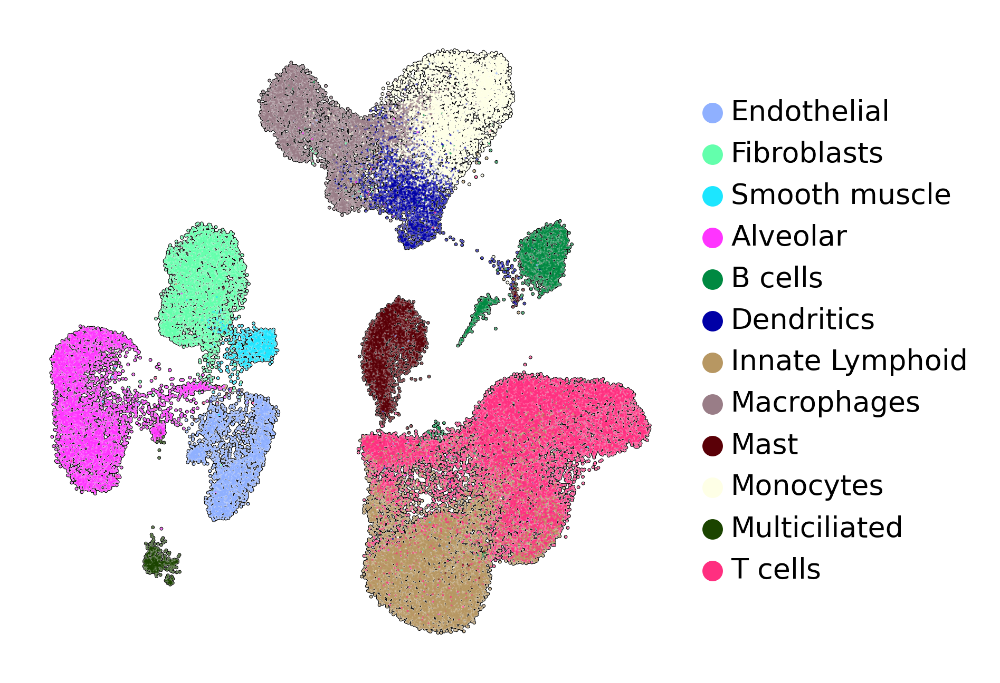

In [168]:
sc.pl.umap(madissoon, color=['CellType_Atlas'], add_outline=True, 
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

## Reyfman

In [34]:
reyfman=sc.read(writepath + 'reyfman2019_processed.h5ad')

/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [36]:
reyfman.obs['CellType_Atlas'].cat.categories

Index(['Epithelial', 'Stroma', 'Remove', 'Endothelial', 'Lymphoid', 'Alveolar',
       'Dendritics', 'Macrophages', 'Mast', 'Monocytes', 'Multiciliated',
       'Secretory'],
      dtype='object')

In [37]:
# remove clusters
ix=np.isin(reyfman.obs['CellType_Atlas'],['Epithelial', 'Stroma', 'Endothelial', 'Lymphoid', 'Alveolar',
       'Dendritics', 'Macrophages', 'Mast', 'Monocytes', 'Multiciliated',
       'Secretory']) 
reyfman=reyfman[ix].copy()

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [169]:
current_cells=np.array(reyfman.obs['CellType_Atlas'].cat.categories)
df_tmp = color.set_index('celltype').loc[current_cells].reset_index(inplace=False)
current_colors=np.array(df_tmp['color'])
reyfman.uns['CellType_Atlas_colors']=current_colors

In [54]:
bbknn.bbknn(reyfman, batch_key='donor')
sc.tl.umap(reyfman)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:08)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:40)


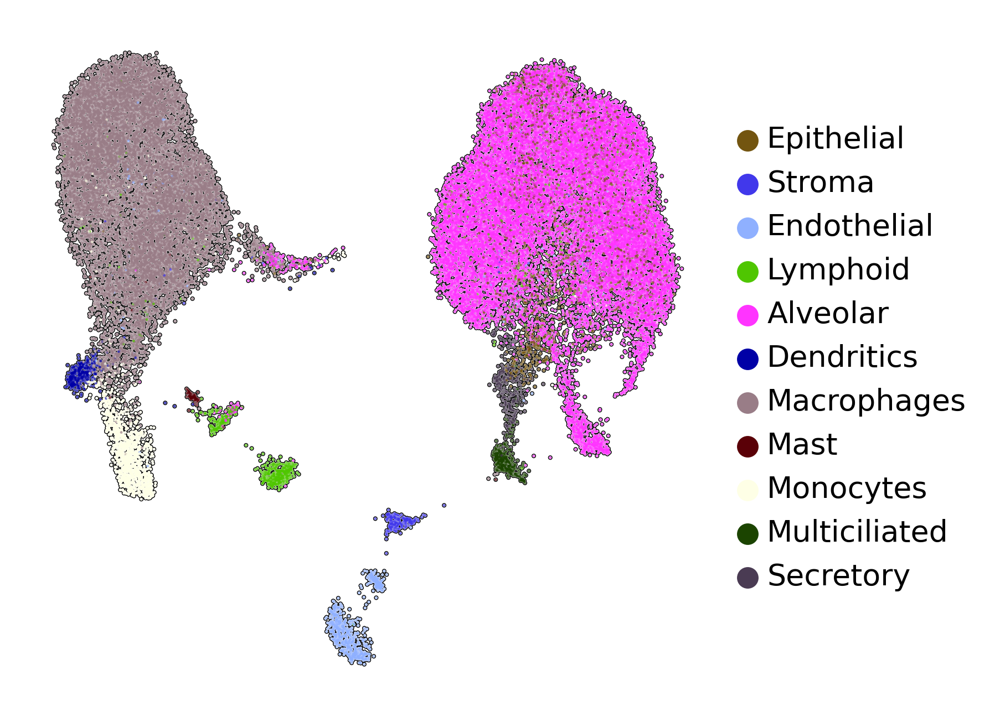

In [170]:
sc.pl.umap(reyfman, color=['CellType_Atlas'], add_outline=True, 
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

## Kim

In [56]:
kimlung=sc.read(writepath + 'kim2020_lung_processed.h5ad')

/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [59]:
kimlung.obs['CellType_Atlas'].cat.categories

Index(['Alveolar', 'B cells', 'Dendritics', 'Endothelial', 'Epithelial',
       'Fibroblasts', 'Lymphoid', 'Macrophages', 'Mast', 'Mesothelial',
       'Monocytes', 'NK cells', 'Smooth muscle', 'T cells', 'Unknown'],
      dtype='object')

In [60]:
# remove clusters
ix=np.isin(kimlung.obs['CellType_Atlas'],['Alveolar', 'B cells', 'Dendritics', 'Endothelial', 'Epithelial',
       'Fibroblasts', 'Lymphoid', 'Macrophages', 'Mast', 'Mesothelial',
       'Monocytes', 'NK cells', 'Smooth muscle', 'T cells']) 
kimlung=kimlung[ix].copy()

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [171]:
current_cells=np.array(kimlung.obs['CellType_Atlas'].cat.categories)
df_tmp = color.set_index('celltype').loc[current_cells].reset_index(inplace=False)
current_colors=np.array(df_tmp['color'])
kimlung.uns['CellType_Atlas_colors']=current_colors

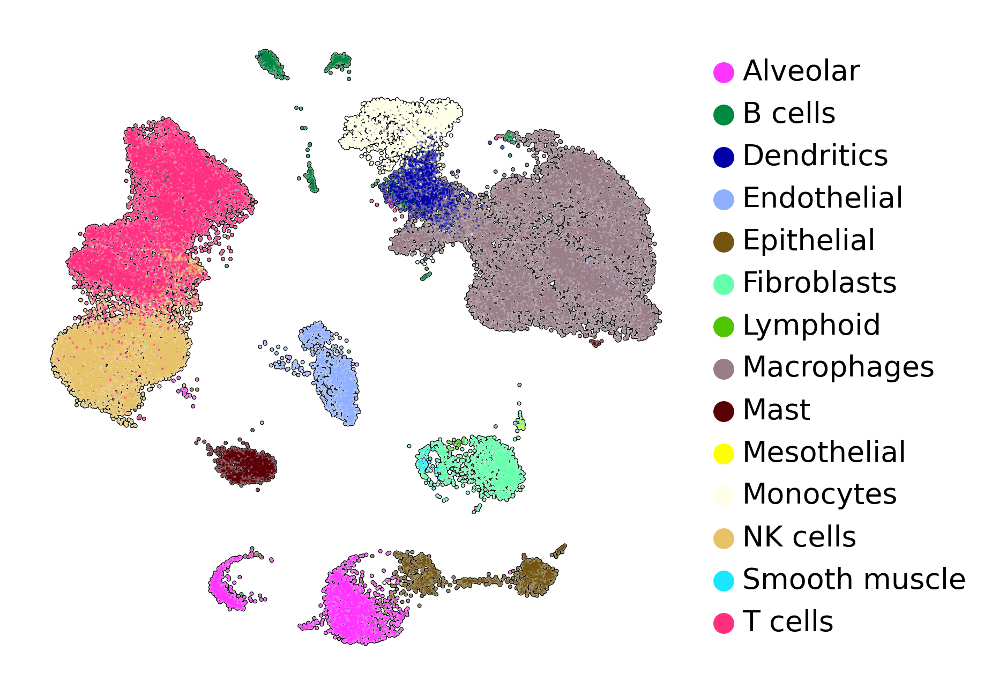

In [172]:
sc.pl.umap(kimlung, color=['CellType_Atlas'], add_outline=True, 
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

# Lymph nodes

## Kim

In [90]:
kimln=sc.read(writepath + 'kim2020_lymphnodes_processed.h5ad')

/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [92]:
kimln.obs['CellType_Atlas'].cat.categories

Index(['B cells', 'Dendritics', 'Monocytes', 'Macrophages', 'T cells',
       'NK cells', 'Remove'],
      dtype='object')

In [93]:
# remove clusters
ix=np.isin(kimln.obs['CellType_Atlas'],['B cells', 'Dendritics', 'Monocytes', 'Macrophages', 'T cells',
       'NK cells']) 
kimln=kimln[ix].copy()

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [173]:
current_cells=np.array(kimln.obs['CellType_Atlas'].cat.categories)
df_tmp = color.set_index('celltype').loc[current_cells].reset_index(inplace=False)
current_colors=np.array(df_tmp['color'])
kimln.uns['CellType_Atlas_colors']=current_colors

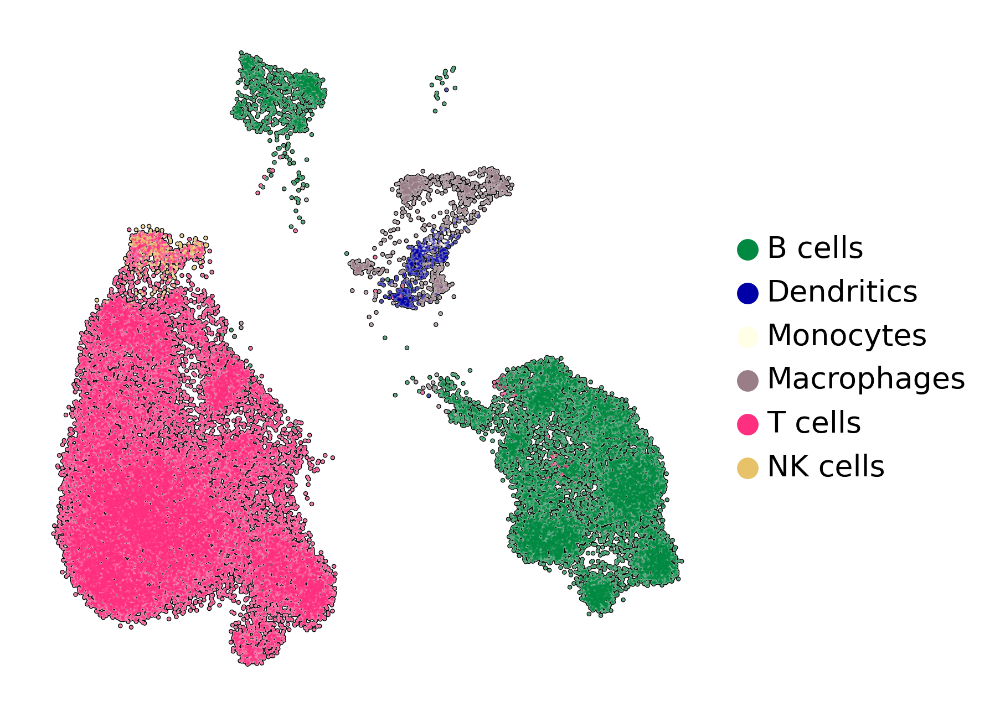

In [174]:
sc.pl.umap(kimln, color=['CellType_Atlas'], add_outline=True,
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

# Liver

## Ramachandran

In [133]:
ramachandran=sc.read(writepath + 'ramachandran2019_processed.h5ad')

/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [189]:
cells=ramachandran.obs.CellType_Atlas.cat.categories[np.isin(ramachandran.obs.CellType_Atlas.cat.categories,color['celltype'])]
new_color=color[color['celltype'].isin(cells)]

# add manually
new_row1 = {'celltype':'Erythroid', 'color':'#4A3B53'}
new_row2 = {'celltype':'Hepatic stellate', 'color':'#1CE6FF'}
new_row3 = {'celltype':'Mesenchymal', 'color':'#7B4F4B'}
new_row4 = {'celltype':'NK cells', 'color':'#e8c268'}



#append row to the dataframe
new_color = new_color.append(new_row1, ignore_index=True)
new_color = new_color.append(new_row2, ignore_index=True)
new_color = new_color.append(new_row3, ignore_index=True)
new_color = new_color.append(new_row4, ignore_index=True)

new_color

,celltype,color
0,Mesothelial,#ffff00
1,B cells,#008941
2,Dendritics,#0000a6
3,Endothelial,#8fb0ff
4,Macrophages,#997d87
5,Mast,#5a0007
6,Lymphoid,#4fc601
7,T cells,#ff2f80
8,Epithelial,#735510
9,Hepatocytes,#0000a6


In [180]:
current_cells=np.array(ramachandran.obs['CellType_Atlas'].cat.categories)
df_tmp = new_color.set_index('celltype').loc[current_cells].reset_index(inplace=False)
current_colors=np.array(df_tmp['color'])
ramachandran.uns['CellType_Atlas_colors']=current_colors

In [185]:
bbknn.bbknn(ramachandran, batch_key='liver')
sc.tl.umap(ramachandran)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:30)


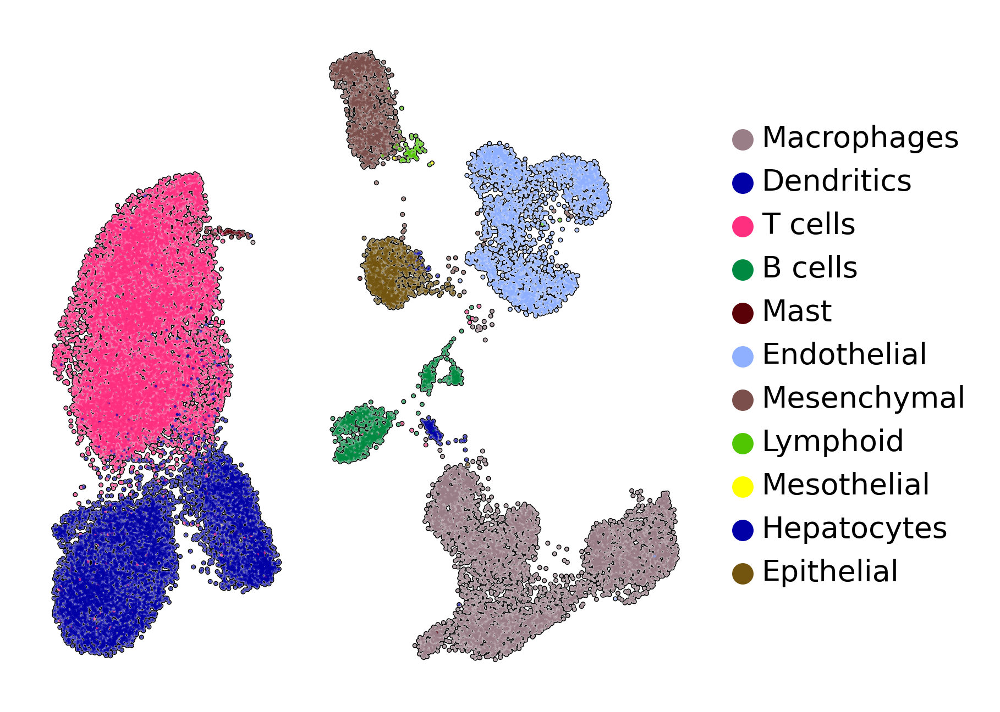

In [187]:
sc.pl.umap(ramachandran, color=['CellType_Atlas'], add_outline=True,
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

## MacParland

In [107]:
macparland=sc.read(writepath + 'macparland2018_processed.h5ad')

/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [190]:
current_cells=np.array(macparland.obs['CellType_Atlas'].cat.categories)
df_tmp = new_color.set_index('celltype').loc[current_cells].reset_index(inplace=False)
current_colors=np.array(df_tmp['color'])
macparland.uns['CellType_Atlas_colors']=current_colors

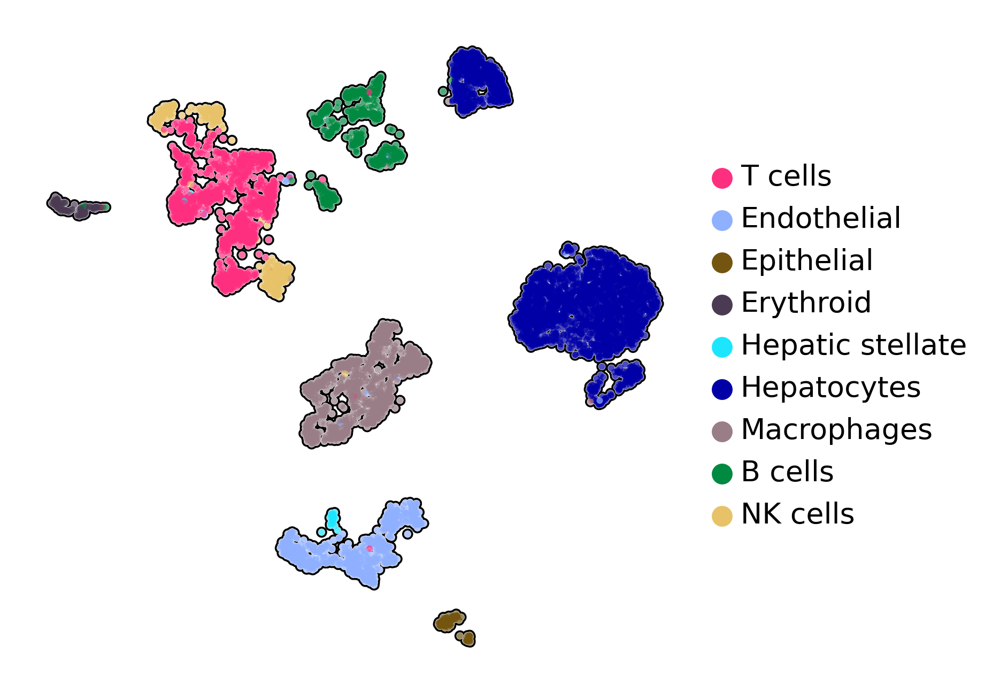

In [191]:
sc.pl.umap(macparland, color=['CellType_Atlas'], add_outline=True,
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

# Kidney

## Steward

In [192]:
steward=sc.read(writepath + 'steward2019_processed.h5ad')

In [205]:
cells=steward.obs.CellType_Atlas.cat.categories[np.isin(steward.obs.CellType_Atlas.cat.categories,color['celltype'])]
new_color=color[color['celltype'].isin(cells)]

# add manually
new_row1 = {'celltype':'Proximal Tubule', 'color':'#4A3B53'}
new_row2 = {'celltype':'Neutrophils', 'color':'#1CE6FF'}
new_row3 = {'celltype':'Podocytes', 'color':'#7B4F4B'}
new_row4 = {'celltype':'Loop of Henle', 'color':'purple'}

#append row to the dataframe
new_color = new_color.append(new_row1, ignore_index=True)
new_color = new_color.append(new_row2, ignore_index=True)
new_color = new_color.append(new_row3, ignore_index=True)
new_color = new_color.append(new_row4, ignore_index=True)

new_color

,celltype,color
0,B cells,#008941
1,Dendritics,#0000a6
2,Fibroblasts,#63ffac
3,Endothelial,#8fb0ff
4,Macrophages,#997d87
5,Mast,#5a0007
6,Monocytes,#feffe6
7,Lymphoid,#4fc601
8,T cells,#ff2f80
9,Epithelial,#735510


In [206]:
current_cells=np.array(steward.obs['CellType_Atlas'].cat.categories)
df_tmp = new_color.set_index('celltype').loc[current_cells].reset_index(inplace=False)
current_colors=np.array(df_tmp['color'])
steward.uns['CellType_Atlas_colors']=current_colors

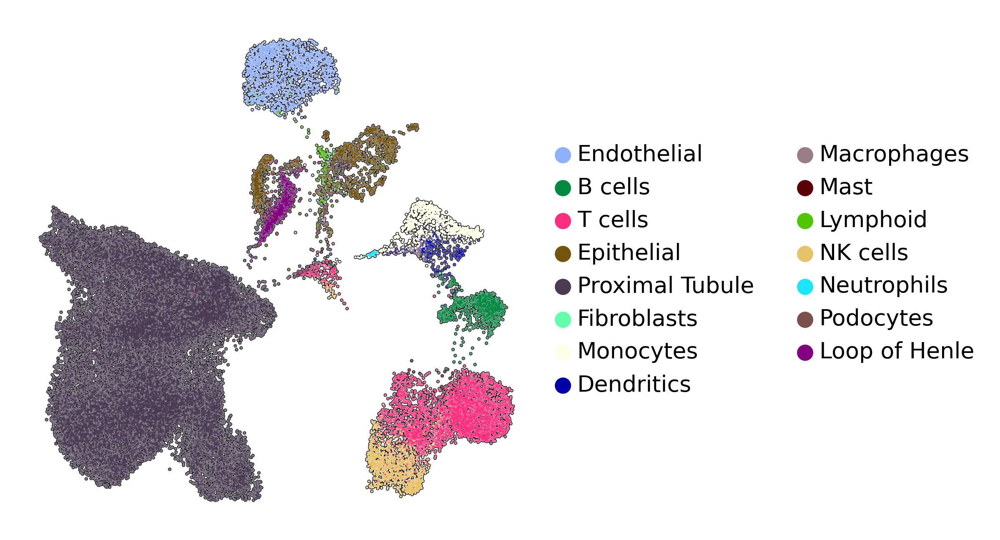

In [208]:
sc.pl.umap(steward, color=['CellType_Atlas'], add_outline=True,
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

# Gut

## Madissoon

In [212]:
madissoon=sc.read(writepath + 'madissoon2019_colon_processed.h5ad')

/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [231]:
color

,celltype,color
0,Mesothelial,#ffff00
1,Smooth muscle,#1ce6ff
2,Alveolar,#ff34ff
3,Arterial,#ff4a46
4,B cells,#008941
5,Basal,#006fa6
6,Bronchial,#a30059
7,Capillary,#ffdbe5
8,Dendritics,#0000a6
9,Fibroblasts,#63ffac


In [232]:
cells=madissoon.obs.CellType_Atlas.cat.categories[np.isin(madissoon.obs.CellType_Atlas.cat.categories,color['celltype'])]
new_color=color[color['celltype'].isin(cells)]

# add manually
new_row1 = {'celltype':'Glands', 'color':'#4A3B53'}
new_row2 = {'celltype':'Innate Lymphoid', 'color':'#b79762'}
new_row3 = {'celltype':'Macrophages', 'color':'#997d87'}
new_row4 = {'celltype':'NK cells', 'color':'#e8c268'}


#append row to the dataframe
new_color = new_color.append(new_row1, ignore_index=True)
new_color = new_color.append(new_row2, ignore_index=True)
new_color = new_color.append(new_row3, ignore_index=True)
new_color = new_color.append(new_row4, ignore_index=True)

new_color

,celltype,color
0,B cells,#008941
1,Basal,#006fa6
2,Dendritics,#0000a6
3,Endothelial,#8fb0ff
4,Mast,#5a0007
5,Monocytes,#feffe6
6,T cells,#ff2f80
7,Epithelial,#735510
8,Stroma,#4138eb
9,Glands,#4A3B53


In [219]:
current_cells=np.array(madissoon.obs['CellType_Atlas'].cat.categories)
df_tmp = new_color.set_index('celltype').loc[current_cells].reset_index(inplace=False)
current_colors=np.array(df_tmp['color'])
madissoon.uns['CellType_Atlas_colors']=current_colors

In [224]:
bbknn.bbknn(madissoon, batch_key='Donor')
sc.tl.umap(madissoon)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:15)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:40)


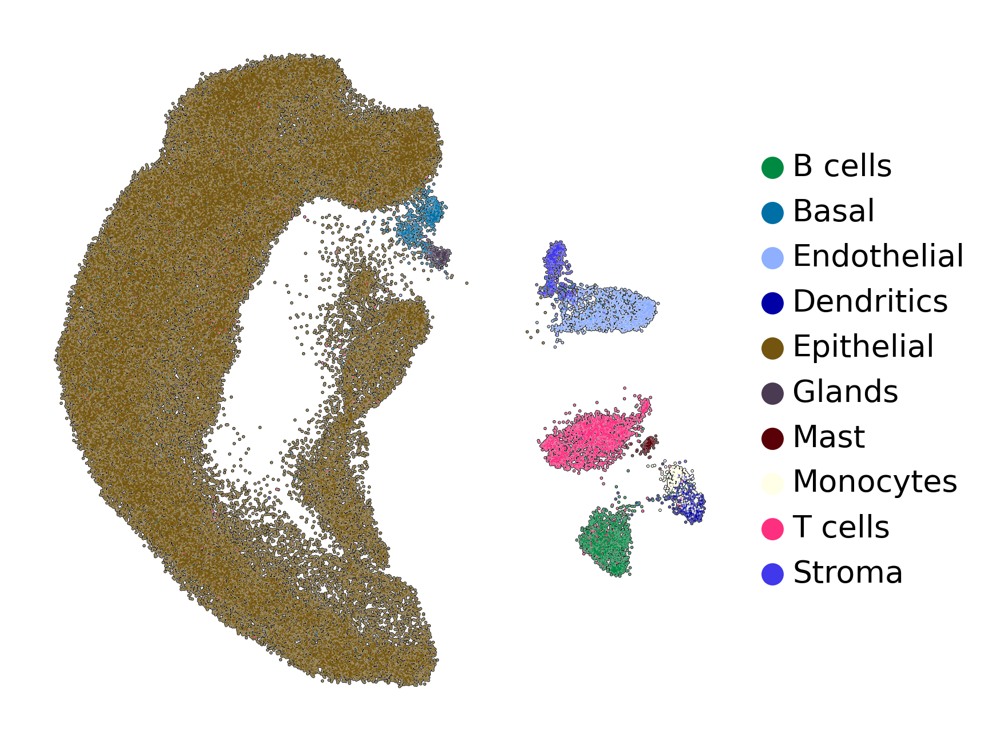

In [227]:
sc.pl.umap(madissoon, color=['CellType_Atlas'], add_outline=True,
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

## James

In [228]:
james=sc.read(writepath + 'james2020_processed.h5ad')

/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [233]:
current_cells=np.array(james.obs['CellType_Atlas'].cat.categories)
df_tmp = new_color.set_index('celltype').loc[current_cells].reset_index(inplace=False)
current_colors=np.array(df_tmp['color'])
james.uns['CellType_Atlas_colors']=current_colors

In [237]:
bbknn.bbknn(james, batch_key='donor')
sc.tl.umap(james)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:05)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:34)


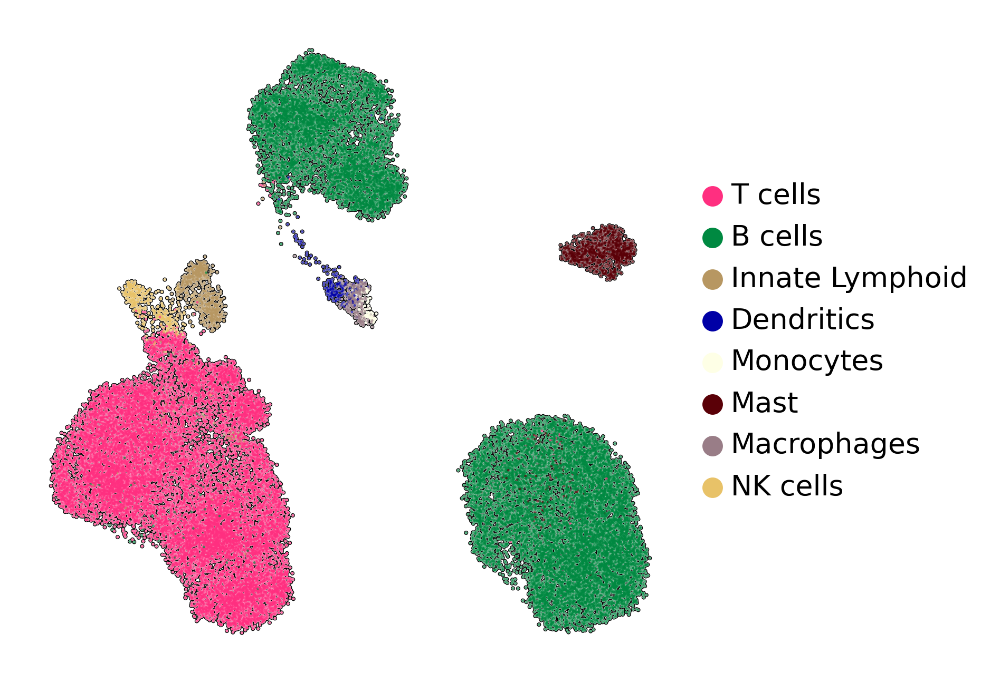

In [239]:
sc.pl.umap(james, color=['CellType_Atlas'], add_outline=True,
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

# Skin

## Cheng

In [240]:
cheng=sc.read(writepath + 'cheng2018_processed.h5ad')

/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [245]:
cheng.uns['CellType_Atlas_colors']=['#4A3B53','#008941','orange','#7B4F4B']

In [251]:
bbknn.bbknn(cheng, batch_key='sample')
sc.tl.umap(cheng)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:16)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:23)


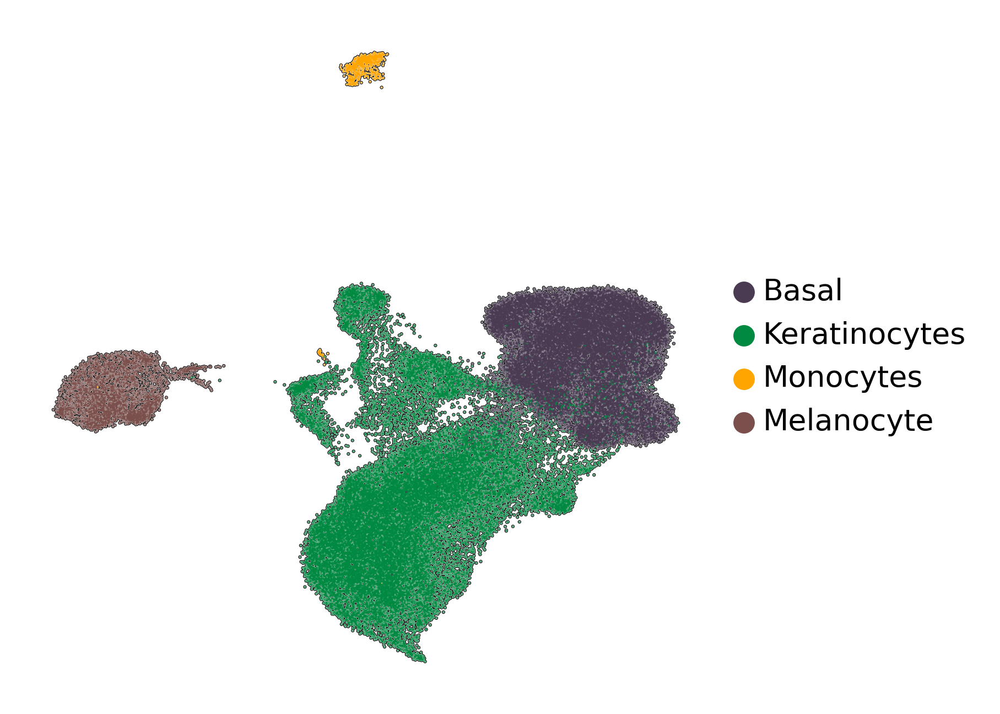

In [253]:
sc.pl.umap(cheng, color=['CellType_Atlas'], add_outline=True,
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')

# Heart

## Han

In [254]:
han=sc.read(writepath + 'han2020_processed.h5ad')

/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/opt/python/lib/python3.8/site-packages/anndata/compat/__init__.py:179: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [257]:
# remove clusters
ix=np.isin(han.obs['CellType_Atlas'],['Cardiomyocyte', 'Dendritics', 'Endothelial', 'Fibroblasts',
       'Macrophages', 'Mast', 'Neutrophils', 'Smooth muscle', 'T cells']) 
han=han[ix].copy()

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [262]:
cells=han.obs.CellType_Atlas.cat.categories[np.isin(han.obs.CellType_Atlas.cat.categories,color['celltype'])]
new_color=color[color['celltype'].isin(cells)]

# add manually
new_row1 = {'celltype':'Cardiomyocyte', 'color':'#008941'}
new_row2 = {'celltype':'Neutrophils', 'color':'#FF4A46'}

#'#4A3B53','#1CE6FF','orange','#7B4F4B','#FF4A46','purple','#008941','purple'

#append row to the dataframe
new_color = new_color.append(new_row1, ignore_index=True)
new_color = new_color.append(new_row2, ignore_index=True)

new_color

,celltype,color
0,Smooth muscle,#1ce6ff
1,Dendritics,#0000a6
2,Fibroblasts,#63ffac
3,Endothelial,#8fb0ff
4,Macrophages,#997d87
5,Mast,#5a0007
6,T cells,#ff2f80
7,Cardiomyocyte,#008941
8,Neutrophils,#FF4A46


In [263]:
current_cells=np.array(han.obs['CellType_Atlas'].cat.categories)
df_tmp = new_color.set_index('celltype').loc[current_cells].reset_index(inplace=False)
current_colors=np.array(df_tmp['color'])
han.uns['CellType_Atlas_colors']=current_colors

In [267]:
bbknn.bbknn(han, batch_key='sample')
sc.tl.umap(han)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


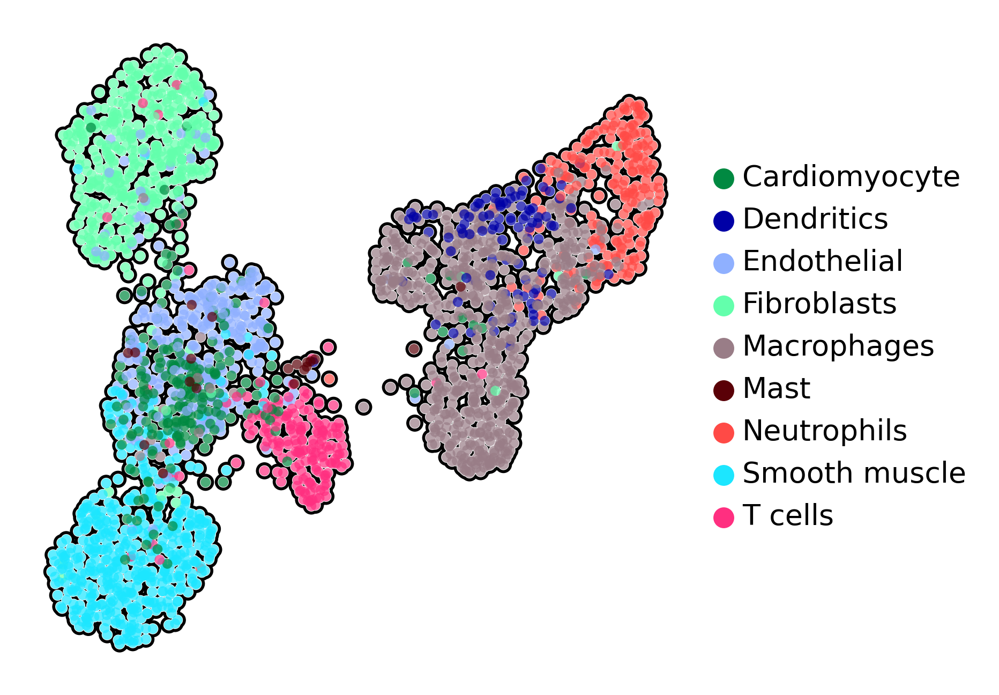

In [269]:
sc.pl.umap(han, color=['CellType_Atlas'], add_outline=True,
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, title='')